In [132]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime

import numpy as np

from sklearn.decomposition import FactorAnalysis, PCA
from sklearn.preprocessing import StandardScaler
from scipy.stats import chi2_contingency
from scipy.stats import chisquare
import xgboost as xgb
import prince
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error

import xgboost as xgb
import shap



import copy
from tqdm.notebook import tqdm
tqdm.pandas()

import warnings
warnings.filterwarnings('ignore')

## Chargement des données

In [2]:
training_df = pd.read_csv("./dataset/training/leaf.csv")
testing_df = pd.read_csv("./dataset/testing/leaf.csv")
df = pd.concat([training_df, testing_df], ignore_index=True)

In [3]:
df.describe()

,demand,destination_current_public_holiday,destination_current_school_holiday,destination_days_to_next_public_holiday,destination_days_to_next_school_holiday,od_destination_time,od_number_of_similar_12_hours,od_number_of_similar_2_hours,od_number_of_similar_4_hours,od_origin_month,...,origin_current_school_holiday,origin_days_to_next_public_holiday,origin_days_to_next_school_holiday,price,sale_day,sale_day_x,sale_month,sale_week,sale_weekday,sale_year
count,665406.000000,665406.0,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,...,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000,665406.000000
mean,3.017909,0.0,0.390637,32.235473,6.527735,918.050354,5.995882,1.411839,2.570497,6.996404,...,0.411005,32.235473,6.353547,24.474385,15.823608,-43.291264,6.450445,3.022477,3.022477,2019.469566
std,7.282832,0.0,0.487893,21.120928,28.194384,255.705077,2.390906,1.354393,1.416591,2.678848,...,0.492016,21.120928,28.146053,16.717205,8.789449,25.274265,2.814974,2.008513,2.008513,0.525622
min,0.000000,0.0,0.000000,0.000000,-58.000000,399.000000,-1.000000,-1.000000,-1.000000,2.000000,...,0.000000,0.000000,-58.000000,11.650000,1.000000,-89.000000,1.000000,0.000000,0.000000,2018.000000
25%,0.000000,0.0,0.000000,13.000000,-12.000000,698.000000,5.000000,0.000000,2.000000,5.000000,...,0.000000,13.000000,-12.000000,11.650000,8.000000,-65.000000,5.000000,1.000000,1.000000,2019.000000
50%,0.000000,0.0,0.000000,31.000000,9.000000,964.000000,6.000000,1.000000,2.000000,8.000000,...,0.000000,31.000000,9.000000,20.650000,16.000000,-42.000000,7.000000,3.000000,3.000000,2019.000000
75%,3.000000,0.0,1.000000,48.000000,30.000000,1088.000000,7.000000,2.000000,4.000000,9.000000,...,1.000000,48.000000,30.000000,29.650000,23.000000,-21.000000,8.000000,5.000000,5.000000,2020.000000
max,192.000000,0.0,1.000000,77.000000,74.000000,1370.000000,10.000000,4.000000,7.000000,11.000000,...,1.000000,77.000000,74.000000,116.650000,31.000000,-1.000000,12.000000,6.000000,6.000000,2020.000000


In [4]:
df.columns

Index(['dataset_type', 'demand', 'departure_date',
       'destination_current_public_holiday',
       'destination_current_school_holiday',
       'destination_days_to_next_public_holiday',
       'destination_days_to_next_school_holiday', 'destination_station_name',
       'od_destination_time', 'od_number_of_similar_12_hours',
       'od_number_of_similar_2_hours', 'od_number_of_similar_4_hours',
       'od_origin_month', 'od_origin_time', 'od_origin_week',
       'od_origin_weekday', 'od_origin_year', 'od_travel_time_minutes',
       'origin_current_public_holiday', 'origin_current_school_holiday',
       'origin_days_to_next_public_holiday',
       'origin_days_to_next_school_holiday', 'origin_station_name', 'price',
       'sale_date', 'sale_day', 'sale_day_x', 'sale_month', 'sale_week',
       'sale_weekday', 'sale_year'],
      dtype='object')

## Analyse exploratoire

### Analyse univariée

#### Colonne dataset_type

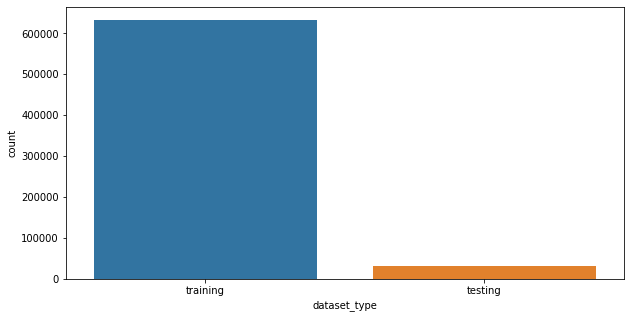

In [5]:
plt.figure(figsize=(10,5))
sns.countplot(x='dataset_type', data=df)

In [6]:
print(f"Les données de validation représentent {df[df.dataset_type=='testing'].shape[0]*100/df.shape[0]}%")

Les données de validation représentent 4.89400456262793%


#### Colonne demand

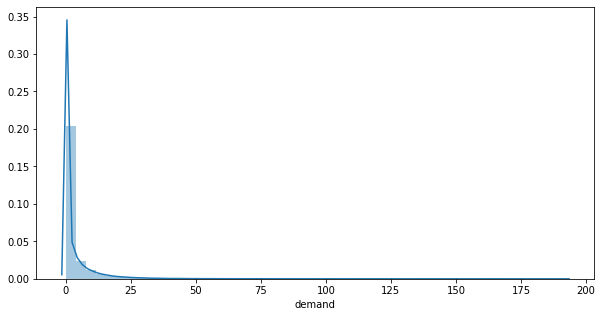

In [7]:
plt.figure(figsize=(10,5))
sns.distplot(df.demand)

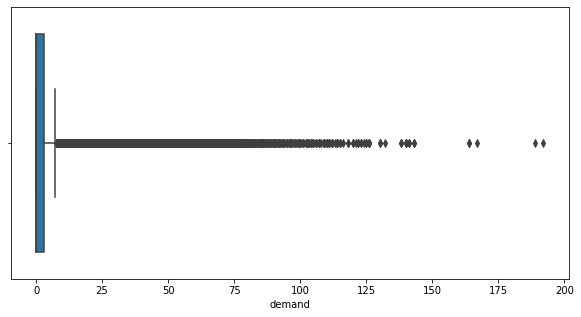

In [8]:
plt.figure(figsize=(10,5))
sns.boxplot(df.demand)

In [9]:
df.demand.describe()

count    665406.000000
mean          3.017909
std           7.282832
min           0.000000
25%           0.000000
50%           0.000000
75%           3.000000
max         192.000000
Name: demand, dtype: float64

**Observations** Plus que 50% des données présente une valeur 0, et il existe des valeurs assez aberrantes au dela de 150, cela peut rendre la création de modèle difficile.

In [10]:
df[df.demand>150].shape[0]

5

In [11]:
df[df.demand>125].shape[0]

21

Nous remarquons qu'il n'existe que 5 valeurs qui dépassent 150 et 21 qui dépassent 125. Ne prenons pas de décision avant 'analyse bivariée

#### Colonne departure_date

In [12]:
df["departure_date"].head()

0    2019-03-01
1    2019-03-01
2    2019-03-01
3    2019-03-01
4    2019-03-01
Name: departure_date, dtype: object

**Observations** Il existe des colonnes représentant l'année et le mois en plus du jour de la semaine. Cette colonne peut générer le jour du mois, ce qui nous permet de dire si le départ se fait en fin du mois par exemple ou au début du mois. Une fois cette colonne extraite ce serait bien de supprimer la colonne date pour éviter la duplication

  0%|          | 0/665406 [00:00<?, ?it/s]

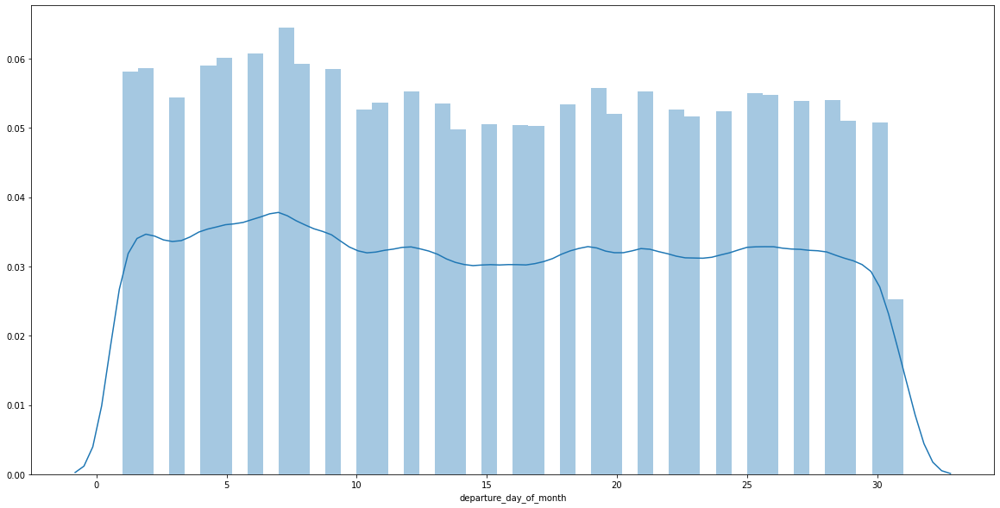

In [13]:
df["departure_day_of_month"] = df.progress_apply(lambda x: int(x.departure_date.split("-")[2]), axis=1)
plt.figure(figsize=(20,10))
sns.distplot(df["departure_day_of_month"])
df = df.drop(["departure_date"], axis=1)

#### Colonne origin_current_public_holiday

In [14]:
df.origin_current_public_holiday.describe()

count    665406.000000
mean          0.032213
std           0.176567
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: origin_current_public_holiday, dtype: float64

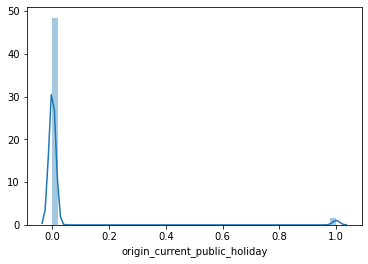

In [15]:
sns.distplot(df.origin_current_public_holiday)

In [16]:
df[df.origin_current_public_holiday==1].shape[0]/df.shape[0]

0.03221341556884068

**Observations** Les jours fériés sur cette colonne représentent 3.22% de l'ensemble des données, il faut survéiller cette rareté si on effectue une analyse multivariée ou en créant un modèle de régression

#### Colonne destination_current_public_holiday

In [17]:
df.destination_current_public_holiday.describe()

count    665406.0
mean          0.0
std           0.0
min           0.0
25%           0.0
50%           0.0
75%           0.0
max           0.0
Name: destination_current_public_holiday, dtype: float64

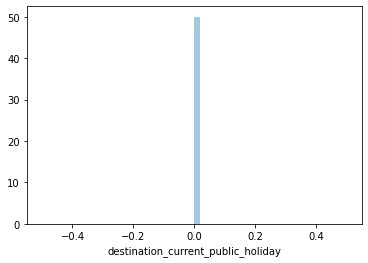

In [18]:
sns.distplot(df.destination_current_public_holiday)

In [19]:
df[df.destination_current_public_holiday==1].shape[0]/df.shape[0]

0.0

**Observations** Les arrivés en jours fériés ne sont pas représentés dans cette colonne. Il faudra l'écarter pour la suite de l'exercicce vu qu'elle ne contient qu'une seule valeur. Je n'arrives pas à expliquer cela vu qu'il y a un nombre considérable de départ les jours fériés, ils ne peuvent pas tous être nocturnes. Vérifions cela

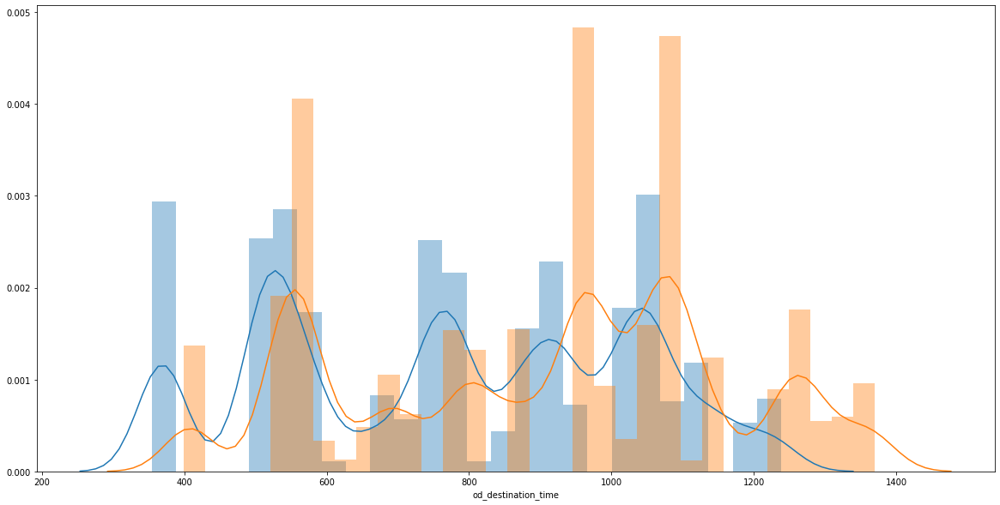

In [20]:
df[df.origin_current_public_holiday==1][["od_origin_time", "od_destination_time"]].describe()
plt.figure(figsize=(20,10))
sns.distplot(df[df.origin_current_public_holiday==1].od_origin_time)
sns.distplot(df[df.origin_current_public_holiday==1].od_destination_time)

**NOTE** On voit que les heures de départs et d'arrivés de ces cas s'étalent sur toute la journée, ce qui ne peut expliquer le fait qu'il n'existe pas de départs en jours fériés qui arrivent en jours fériés

In [21]:
df = df.drop(["destination_current_public_holiday"], axis=1)

#### Colonne origin_current_school_holiday

Pourcentage des jours de vacances scolaires dans le dataset 41.10047099064331%


count    665406.000000
mean          0.411005
std           0.492016
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           1.000000
Name: origin_current_school_holiday, dtype: float64

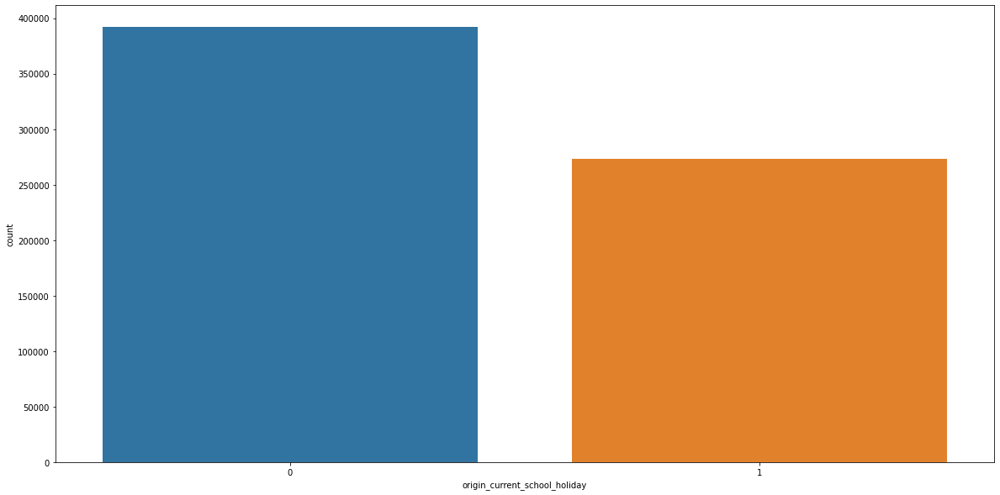

In [22]:
plt.figure(figsize=(20,10))
sns.countplot(df.origin_current_school_holiday)
print(f"Pourcentage des jours de vacances scolaires dans le dataset {df[df.origin_current_school_holiday==1].shape[0]*100/df.shape[0]}%")
df.origin_current_school_holiday.describe()

**observations** Colonne catégorique, avec un peu plus de 41% des données qui a la valeur 1

#### Colonne destination_current_school_holiday

Pourcentage des départs en jours de vacances scolaires dans le dataset 39.06366939883319%


count    665406.000000
mean          0.390637
std           0.487893
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           1.000000
Name: destination_current_school_holiday, dtype: float64

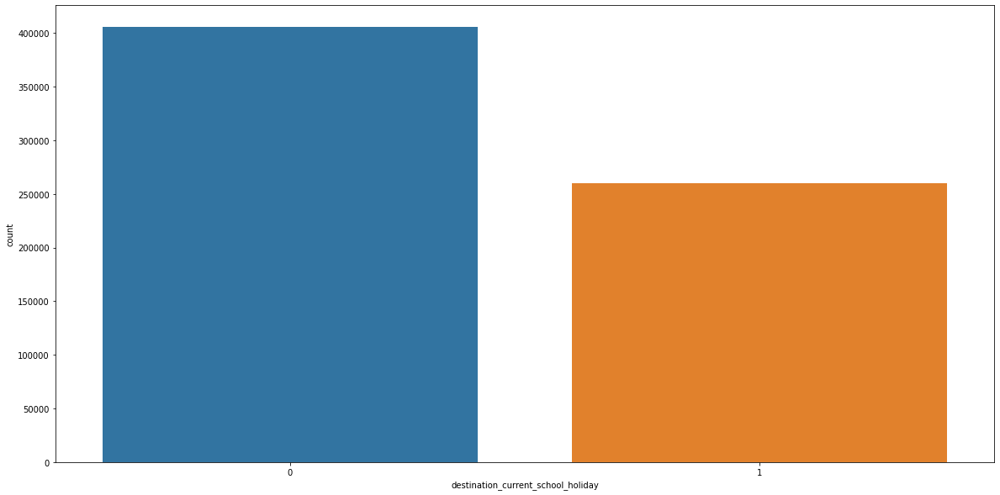

In [23]:
plt.figure(figsize=(20,10))
sns.countplot(df.destination_current_school_holiday)
print(f"Pourcentage des départs en jours de vacances scolaires dans le dataset {df[df.destination_current_school_holiday==1].shape[0]*100/df.shape[0]}%")
df.destination_current_school_holiday.describe()

**observations** Colonne catégorique, avec un peu plus de 39% des données qui a la valeur 1. Cela reste cohérents avec les départs

#### Colonne origin_days_to_next_public_holiday

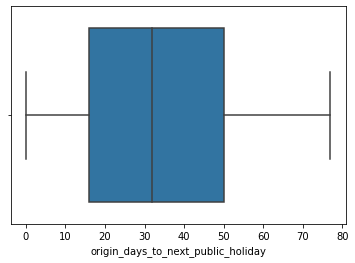

In [24]:
sns.boxplot(training_df.origin_days_to_next_public_holiday)

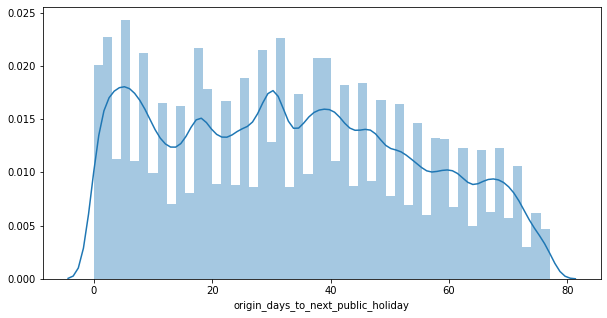

In [25]:
plt.figure(figsize=(10,5))
sns.distplot(training_df.origin_days_to_next_public_holiday)

**Observations** Même si la capture ne couvre pas les différentes valeurs de façon normale ni uniforme (on retrouve des piques en plein milieu de deux valeurs basses) la Boxplot permet de voir qu'on peut mettre des intervales indiquant qu'il y a peu, un peu plus ou trop de jours avant le jour férié (transformer cette colonne en une variable qualitative peut s'avérer utile dans le sens où on tient directement une information intuitive au risque de perdre de l'information dans l'échange)

#### Colonne destination_days_to_next_public_holiday

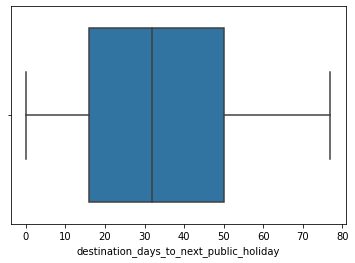

In [26]:
sns.boxplot(training_df.destination_days_to_next_public_holiday)

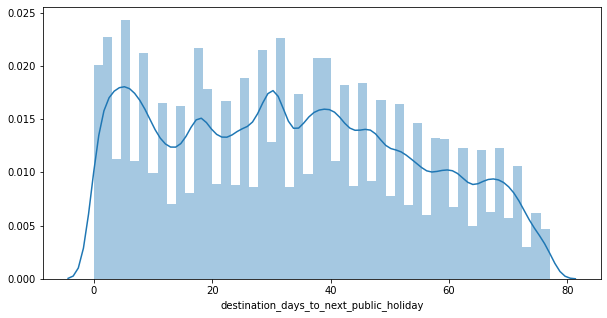

In [27]:
plt.figure(figsize=(10,5))
sns.distplot(training_df.destination_days_to_next_public_holiday)

  0%|          | 0/665406 [00:00<?, ?it/s]

,dataset_type,demand,destination_current_school_holiday,destination_days_to_next_public_holiday,destination_days_to_next_school_holiday,destination_station_name,od_destination_time,od_number_of_similar_12_hours,od_number_of_similar_2_hours,od_number_of_similar_4_hours,...,origin_station_name,price,sale_date,sale_day,sale_day_x,sale_month,sale_week,sale_weekday,sale_year,departure_day_of_month


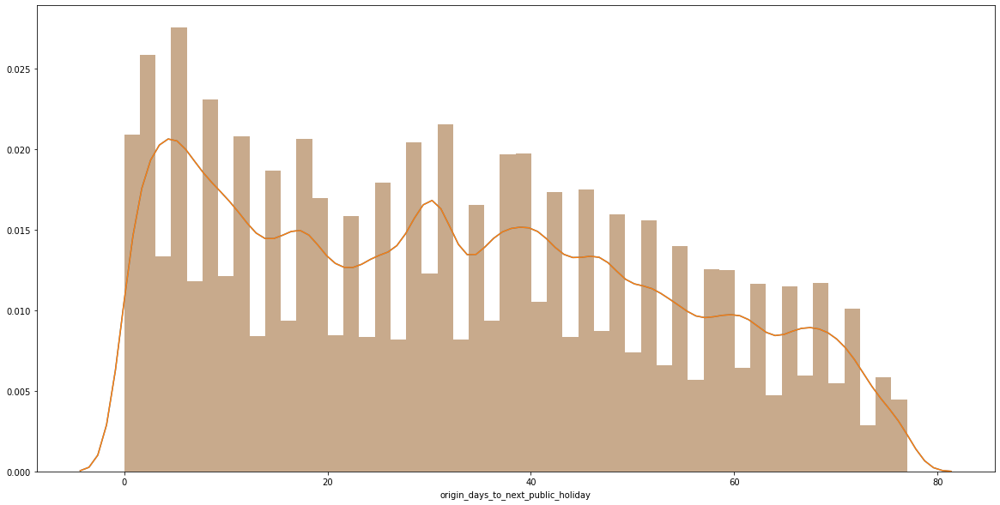

In [28]:
plt.figure(figsize=(20,10))
sns.distplot(df.destination_days_to_next_public_holiday)
sns.distplot(df.origin_days_to_next_public_holiday)
df[df.progress_apply(lambda x: x.origin_days_to_next_public_holiday != x.destination_days_to_next_public_holiday, axis=1)]

**NOTE** Superpostion totale des deux variables, Il vaut mieux en supprimer une

In [29]:
df = df.drop(["destination_days_to_next_public_holiday"], 1)

#### Colonne origin_days_to_next_school_holiday

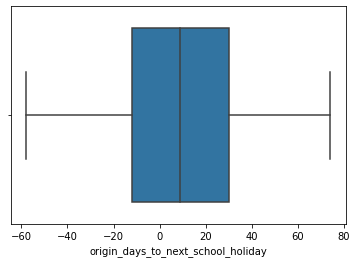

In [30]:
sns.boxplot(df.origin_days_to_next_school_holiday)

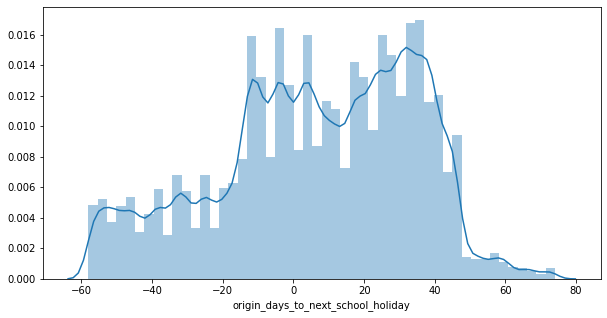

In [31]:
plt.figure(figsize=(10,5))
sns.distplot(df.origin_days_to_next_school_holiday)

**Observations** Même si la capture ne couvre pas les différentes valeurs de façon normale ni uniforme (on retrouve des piques en plein milieu de deux valeurs basses) la Boxplot permet de voir qu'on peut mettre des intervales indiquant qu'il y a peu, un peu plus ou trop de jours avant le jour férié (transformer cette colonne en une variable qualitative peut s'avérer utile dans le sens où on tient directement une information intuitive au risque de perdre de l'information dans l'échange)

#### Colonne destination_days_to_next_school_holiday

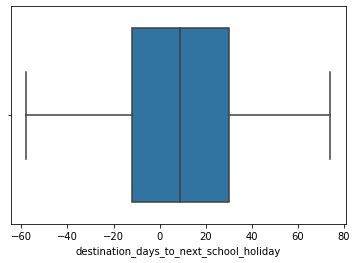

In [32]:
sns.boxplot(df.destination_days_to_next_school_holiday)

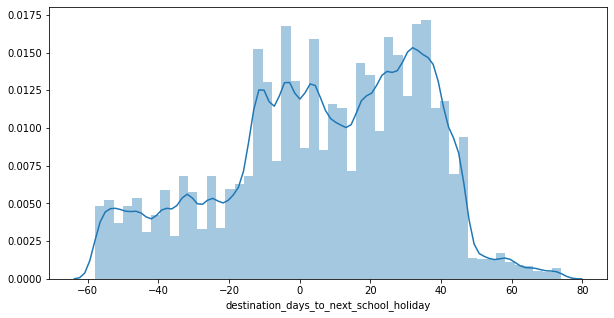

In [33]:
plt.figure(figsize=(10,5))
sns.distplot(df.destination_days_to_next_school_holiday)

  0%|          | 0/665406 [00:00<?, ?it/s]

,origin_days_to_next_school_holiday,destination_days_to_next_school_holiday
0,-6,-13
1,-6,-13
2,-6,-13
3,-6,-13
4,-6,-13
...,...,...
391628,28,21
391629,28,21
391630,21,28
391634,21,28


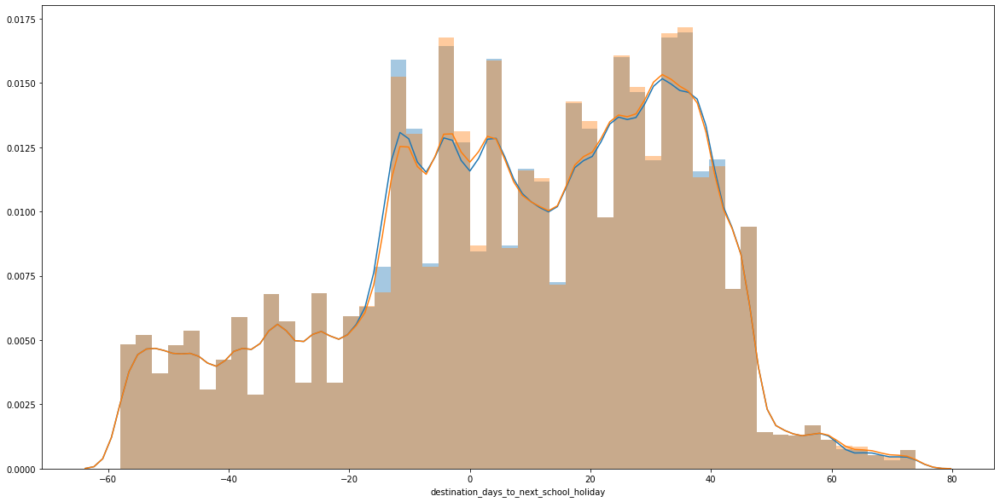

In [34]:
plt.figure(figsize=(20,10))
sns.distplot(df.origin_days_to_next_school_holiday)
sns.distplot(df.destination_days_to_next_school_holiday)
df[df.progress_apply(lambda x: x.destination_days_to_next_school_holiday != x.origin_days_to_next_school_holiday, axis=1)][["origin_days_to_next_school_holiday", "destination_days_to_next_school_holiday"]]

**NOTE** Les variables sont assez proches nou vérifierons pendant l'analyse bivariée leur corrélation

#### Colonne origin_station_name

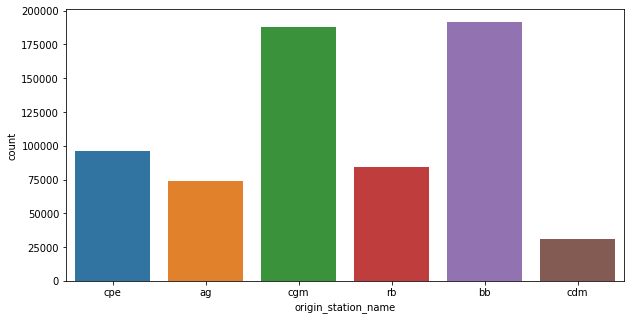

In [35]:
plt.figure(figsize=(10, 5))
sns.countplot(df.origin_station_name)

**Observations** la valeur cdm est assez rare, cela pourrait poser un problème au cas où on s'oriente vers une analyse en composantes multiples pour les variables catégoriques

#### Colonne destination_station_name

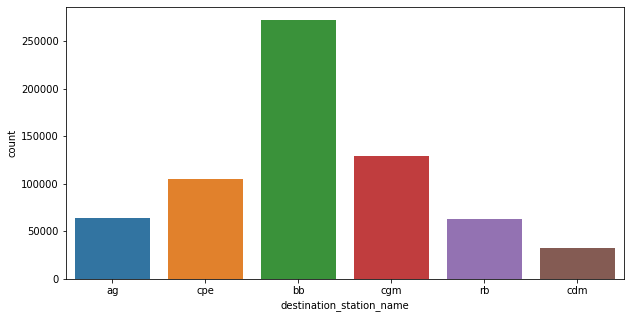

In [36]:
plt.figure(figsize=(10, 5))
sns.countplot(df.destination_station_name)

**Observations** la valeur cdm est assez rare, cela pourrait poser un problème au cas où on s'oriente vers une analyse en composantes multiples pour les variables catégoriques

Ce serait bien de rajouter une colonne trajet représentant les correspondances départ-arrivé, ce sera plus descriptif pour le métier. Nous verrons par la suite si on va garder les deux autres colonnes ou bien les supprimer (selon l'analyse bivariée)

In [37]:
df["track_stations"] = df.progress_apply(lambda x: x.origin_station_name+"-"+x.destination_station_name,axis=1)

  0%|          | 0/665406 [00:00<?, ?it/s]

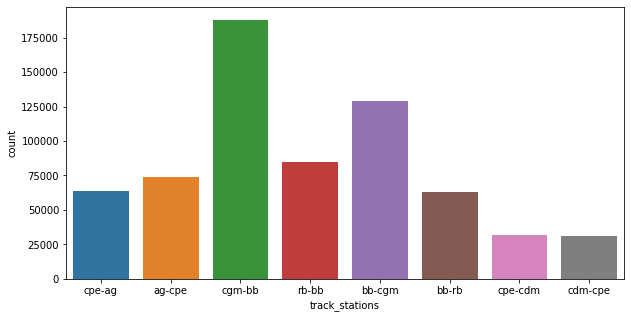

In [38]:
plt.figure(figsize=(10, 5))
sns.countplot(df.track_stations)

#### Colonne od_origin_time

In [39]:
df.od_origin_time.describe()

count    665406.000000
mean        798.292336
std         244.055547
min         354.000000
25%         576.000000
50%         785.000000
75%        1021.000000
max        1238.000000
Name: od_origin_time, dtype: float64

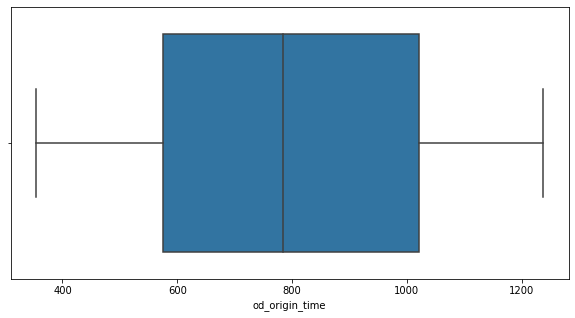

In [40]:
plt.figure(figsize=(10,5))
sns.boxplot(df.od_origin_time)

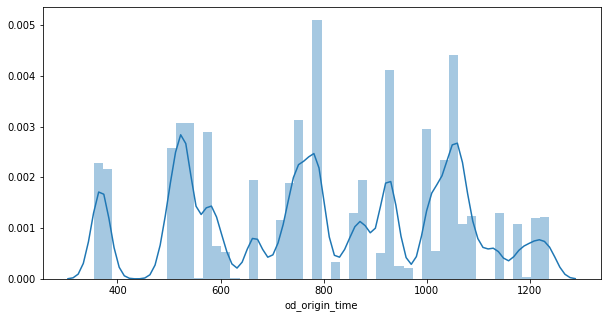

In [41]:
plt.figure(figsize=(10,5))
sns.distplot(df.od_origin_time)

**Observations** On remarque dans la distribution la présence de valeurs discontinues et la box plot suggère une bonne séparation entre les quantils. Nous pouvons imaginer une transformation en une variable catégorique pour représenter les départ du matin, mi journée et soir.
Un point de détail, on peut extraire une autre colonne trajets de nuit à partir de l'heure d'embarquement si elle est supérieur à une valeur de 1140 (19h)

In [42]:
df["night_origin"] = df.progress_apply(lambda x: x.od_origin_time>=1140, axis=1)

  0%|          | 0/665406 [00:00<?, ?it/s]

Les trajets qui partent la nuit représentent 6.227776725788466%


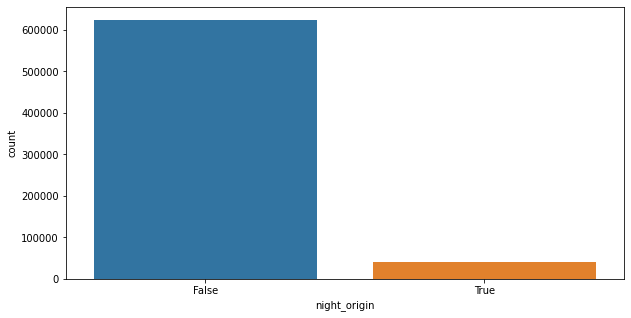

In [43]:
plt.figure(figsize=(10,5))
sns.countplot(df.night_origin)
print(f"Les trajets qui partent la nuit représentent {df[df.night_origin].shape[0]*100/df.shape[0]}%")

#### Colonne od_destination_time

In [44]:
df.od_destination_time.describe()

count    665406.000000
mean        918.050354
std         255.705077
min         399.000000
25%         698.000000
50%         964.000000
75%        1088.000000
max        1370.000000
Name: od_destination_time, dtype: float64

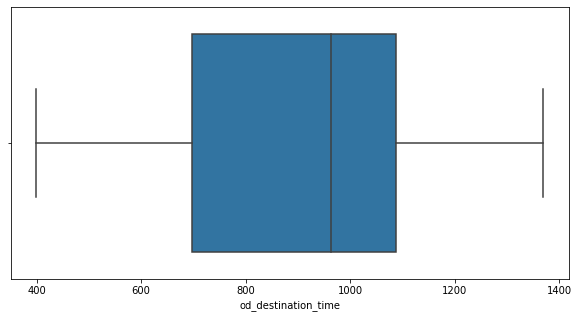

In [45]:
plt.figure(figsize=(10,5))
sns.boxplot(df.od_destination_time)

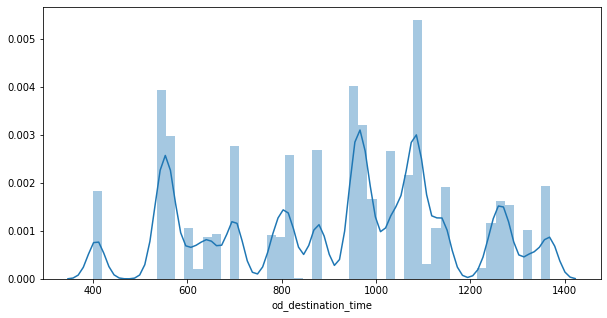

In [46]:
plt.figure(figsize=(10,5))
sns.distplot(df.od_destination_time)

In [47]:
df["night_destination"] = df.progress_apply(lambda x: x.od_destination_time>=1140, axis=1)

  0%|          | 0/665406 [00:00<?, ?it/s]

Les trajets qui arrivent la nuit représentent 18.281620544449556%


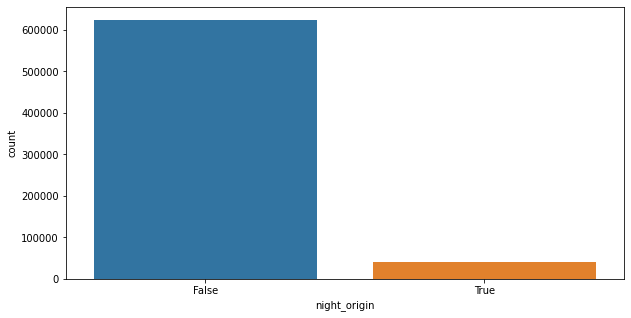

In [48]:
plt.figure(figsize=(10,5))
sns.countplot(df.night_origin)
print(f"Les trajets qui arrivent la nuit représentent {df[df.night_destination].shape[0]*100/df.shape[0]}%")

#### Colonne od_number_of_similar_12_hours

In [49]:
df.od_number_of_similar_12_hours.describe()

count    665406.000000
mean          5.995882
std           2.390906
min          -1.000000
25%           5.000000
50%           6.000000
75%           7.000000
max          10.000000
Name: od_number_of_similar_12_hours, dtype: float64

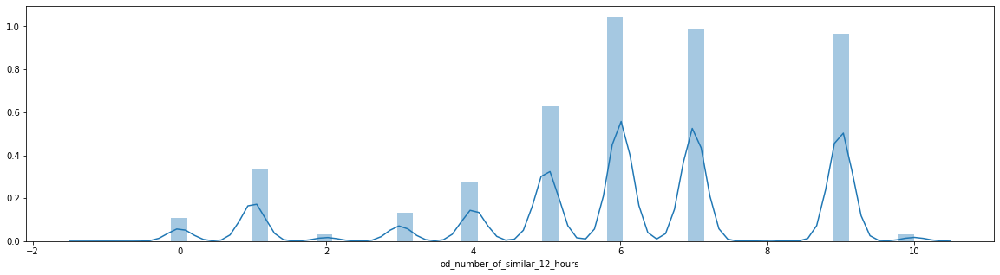

In [50]:
plt.figure(figsize=(20,5))

sns.distplot(df.od_number_of_similar_12_hours)

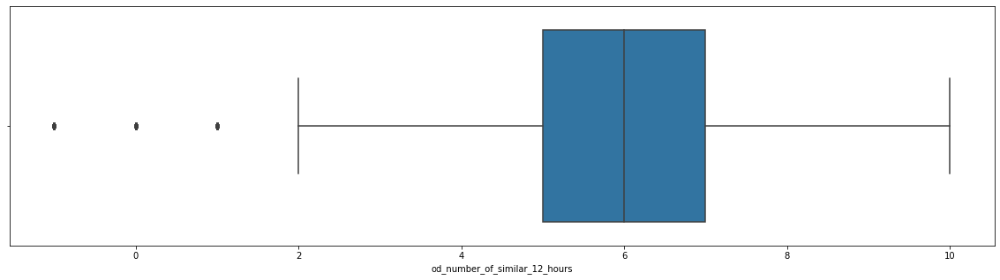

In [51]:
plt.figure(figsize=(20,5))

sns.boxplot(df.od_number_of_similar_12_hours)

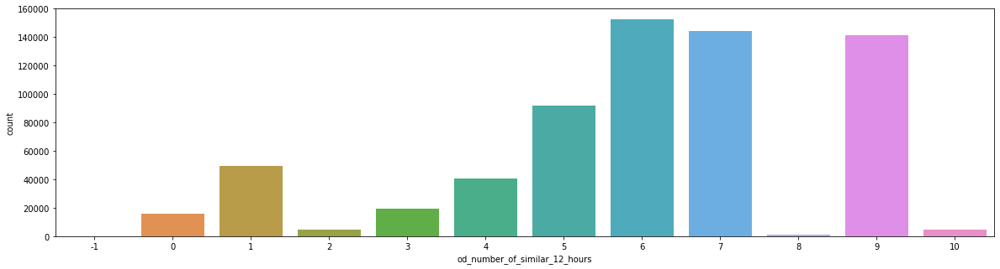

In [52]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_number_of_similar_12_hours)

In [53]:
print(f"Données manquantes : {df[df.od_number_of_similar_12_hours<0].shape[0]*100/df.shape[0]}%")

Données manquantes : 0.006612504245528294%


**Observations** Les données manquantes sont très rares, on peut donc même imaginer supprimer les enregistrements correspondants si cette colonne s'avère pertinente par rapport à la variable de demande

Les modalités -1,2,8 et 10 semblent trop rares, il faut faire attention en cas d'utilisation de l'ACM

#### Colonne od_number_of_similar_4_hours

In [54]:
df.od_number_of_similar_4_hours.describe()

count    665406.000000
mean          2.570497
std           1.416591
min          -1.000000
25%           2.000000
50%           2.000000
75%           4.000000
max           7.000000
Name: od_number_of_similar_4_hours, dtype: float64

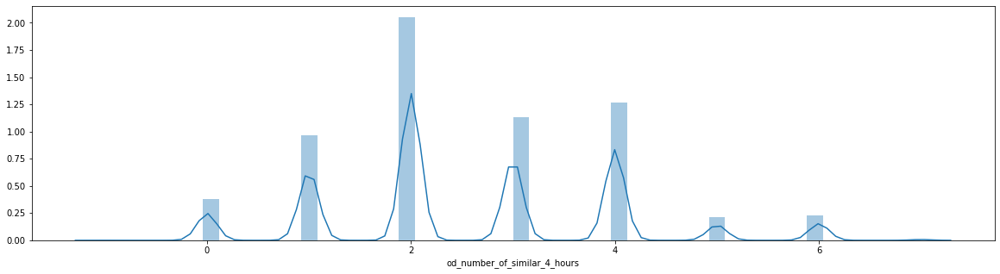

In [55]:
plt.figure(figsize=(20,5))

sns.distplot(df.od_number_of_similar_4_hours)

count    665406.000000
mean          2.570497
std           1.416591
min          -1.000000
25%           2.000000
50%           2.000000
75%           4.000000
max           7.000000
Name: od_number_of_similar_4_hours, dtype: float64

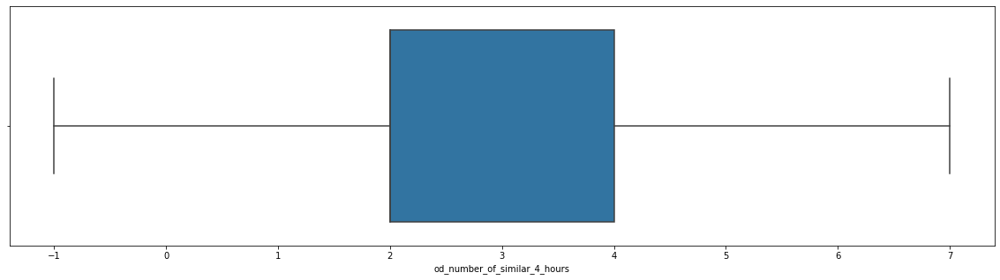

In [56]:
plt.figure(figsize=(20,5))

sns.boxplot(df.od_number_of_similar_4_hours)
df.od_number_of_similar_4_hours.describe()

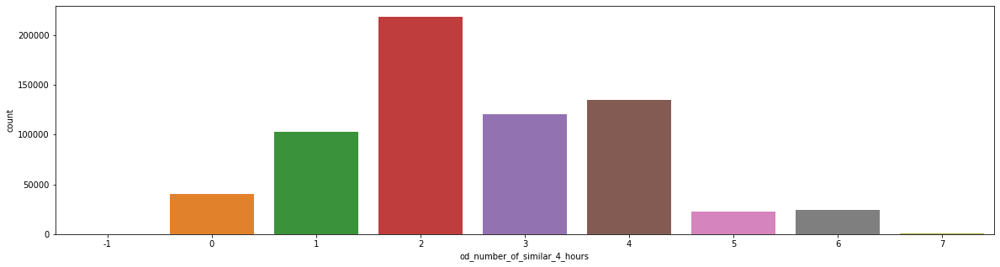

In [57]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_number_of_similar_4_hours)

In [58]:
print(f"Données manquantes : {df[df.od_number_of_similar_4_hours<0].shape[0]*100/df.shape[0]}%")

Données manquantes : 0.006612504245528294%


**Observations** Les données manquantes sont très rares, on peut donc même imaginer supprimer les enregistrements correspondants si cette colonne s'avère pertinente par rapport à la variable de demande

Les modalités -1 et 7 semblent trop rares, il faut faire attention en cas d'utilisation de l'ACM

#### Colonne od_number_of_similar_2_hours

In [59]:
df.od_number_of_similar_2_hours.describe()

count    665406.000000
mean          1.411839
std           1.354393
min          -1.000000
25%           0.000000
50%           1.000000
75%           2.000000
max           4.000000
Name: od_number_of_similar_2_hours, dtype: float64

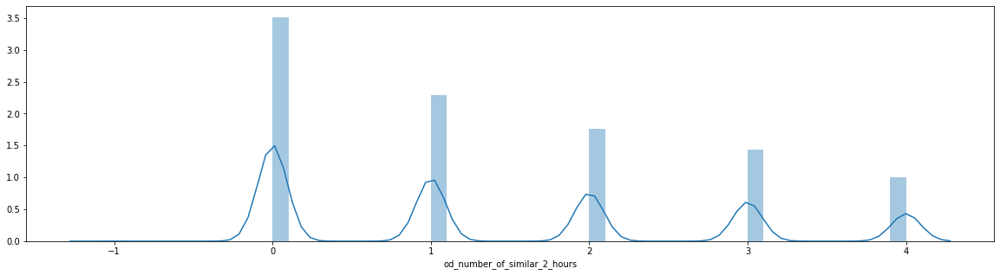

In [60]:
plt.figure(figsize=(20,5))

sns.distplot(df.od_number_of_similar_2_hours)

count    665406.000000
mean          2.570497
std           1.416591
min          -1.000000
25%           2.000000
50%           2.000000
75%           4.000000
max           7.000000
Name: od_number_of_similar_4_hours, dtype: float64

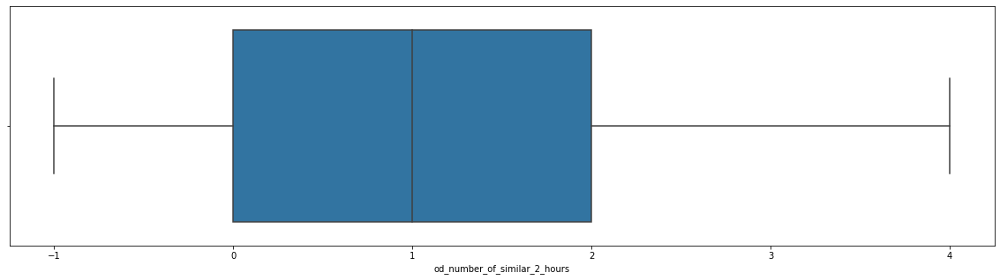

In [61]:
plt.figure(figsize=(20,5))

sns.boxplot(df.od_number_of_similar_2_hours)
df.od_number_of_similar_4_hours.describe()

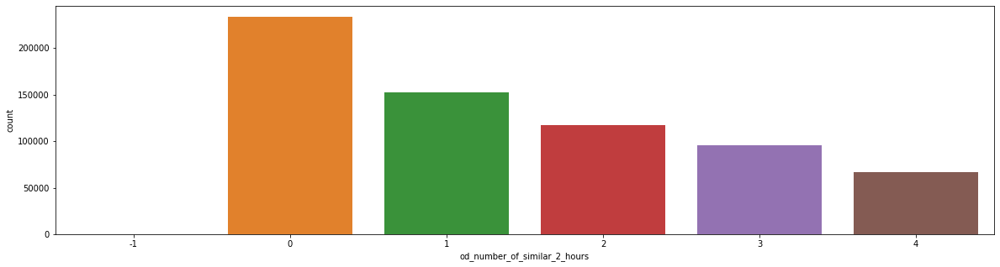

In [62]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_number_of_similar_2_hours)

In [63]:
print(f"Données manquantes : {df[df.od_number_of_similar_2_hours<0].shape[0]*100/df.shape[0]}%")

Données manquantes : 0.015028418739837032%


**Observations** Les données manquantes sont rares, on peut donc même imaginer supprimer les enregistrements correspondants si cette colonne s'avère pertinente par rapport à la variable de demande

La modalité -1 semble trop rares, il faut faire attention en cas d'utilisation de l'ACM

#### Colonne od_origin_month

In [64]:
df.od_origin_month.describe()

count    665406.000000
mean          6.996404
std           2.678848
min           2.000000
25%           5.000000
50%           8.000000
75%           9.000000
max          11.000000
Name: od_origin_month, dtype: float64

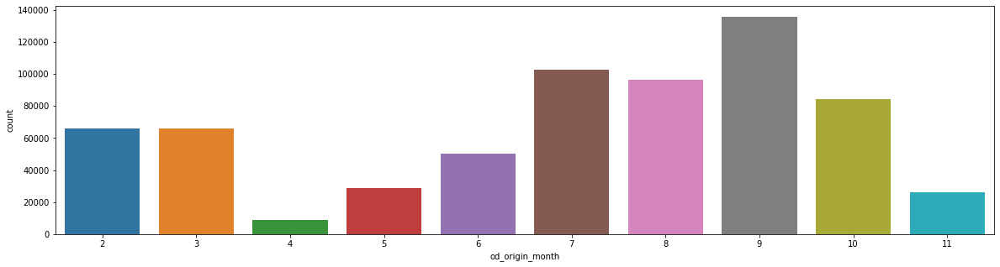

In [65]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_origin_month)

**observations** Cette variable est catégorique, il semble que les mois 1 et 12 soient absents, nous notons une charge importante pendant les mois de l'été et un manque de données pour le mois d'avril, à tenir en considération au cas où on a recours à l'ACM

#### Colonne od_origin_week

In [66]:
df.od_origin_week.describe()

count    665406.000000
mean         28.872657
std          11.866471
min           5.000000
25%          22.000000
50%          32.000000
75%          38.000000
max          48.000000
Name: od_origin_week, dtype: float64

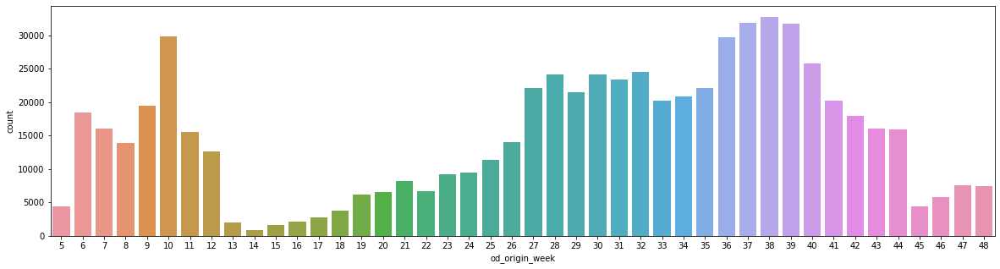

In [67]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_origin_week)

**observations** Cette variable est catégorique, il semble que les semaine correspondantes aux mois 1 et 12 soient absents, nous notons une charge importante pendant les mois de l'été et un manque de données pour le mois d'avril, à tenir en considération au cas où on a recours à l'ACM

Cette colonne permet de représenter avec plus de granularité les données de la colonne du mois, il faut envisager de ne garder qu'une seule pour la suite

#### Colonne od_origin_weekday

In [68]:
df.od_origin_weekday.describe()

count    665406.000000
mean          2.835727
std           1.940801
min           0.000000
25%           1.000000
50%           3.000000
75%           5.000000
max           6.000000
Name: od_origin_weekday, dtype: float64

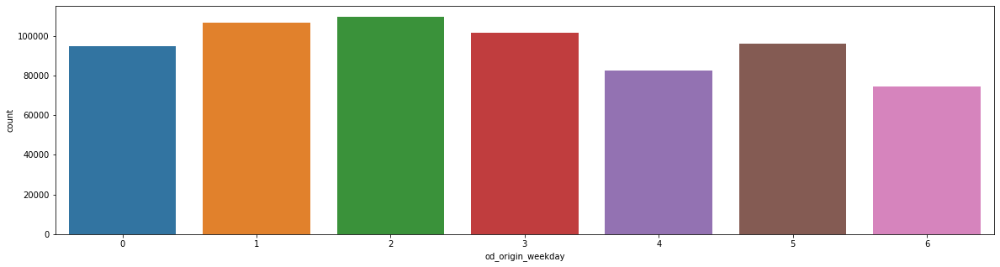

In [69]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_origin_weekday)

**observations** Répartition assez uniforme des données, on peut extraire la colonne indiquant les voyage de week end à partir de cette colonne

In [70]:
df["is_week_end"] = df.progress_apply(lambda x: x.od_origin_weekday>=5, axis=1)

  0%|          | 0/665406 [00:00<?, ?it/s]

#### Colonne od_origin_year

In [71]:
df.od_origin_year.describe()

count    665406.000000
mean       2019.543428
std           0.498111
min        2019.000000
25%        2019.000000
50%        2020.000000
75%        2020.000000
max        2020.000000
Name: od_origin_year, dtype: float64

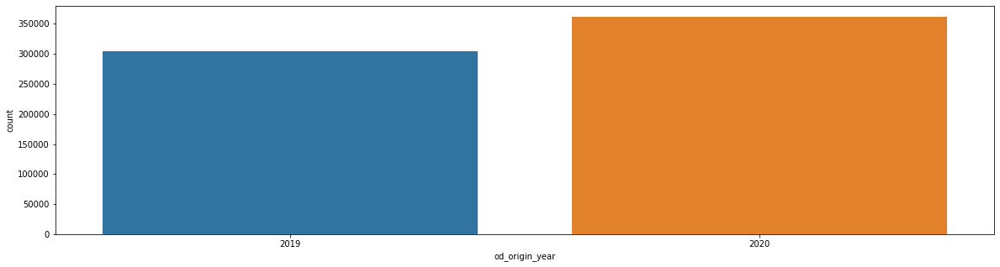

In [72]:
plt.figure(figsize=(20,5))
sns.countplot(df.od_origin_year)

**observations** Répartition assez équilibrée des données, même si on s'attend à moins de données sur 2020 à cause de la pandémie, il faut étudier la pertinence de cette colonne soigneusement pendant l'analyse bi-variée

#### Colonne departure_day_of_month

In [73]:
df.departure_day_of_month.describe()

count    665406.000000
mean         15.394373
std           8.864450
min           1.000000
25%           8.000000
50%          15.000000
75%          23.000000
max          31.000000
Name: departure_day_of_month, dtype: float64

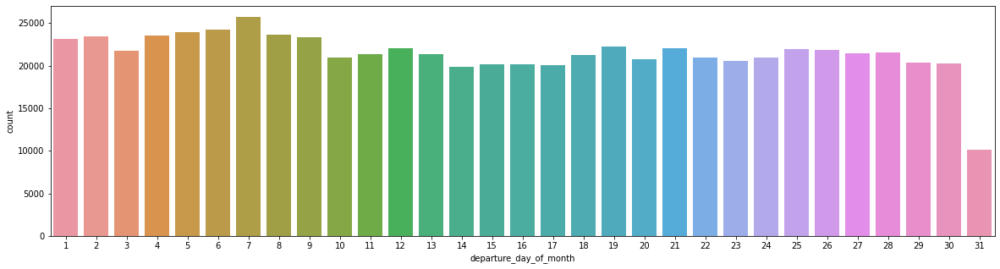

In [74]:
plt.figure(figsize=(20,5))
sns.countplot(df.departure_day_of_month)

**observations** Répartition assez uniforme des données, les valeurs pour 31 correspondent vu qu'il s'agit d'à peu près un mois sur deux. On peut extraire les voyages de fin de mois

In [75]:
df["is_eom_track"] = df.progress_apply(lambda x: x.departure_day_of_month>=28, axis=1)

  0%|          | 0/665406 [00:00<?, ?it/s]

#### Colonne sale_day_x

In [76]:
df.sale_day_x.describe

<bound method NDFrame.describe of 0        -89
1        -88
2        -87
3        -86
4        -85
          ..
665401    -5
665402    -4
665403    -3
665404    -2
665405    -1
Name: sale_day_x, Length: 665406, dtype: int64>

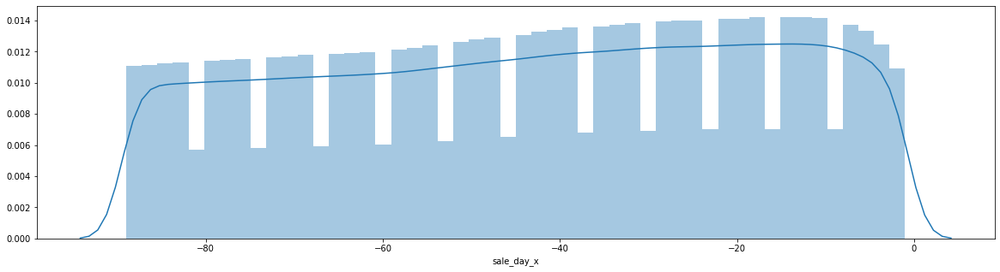

In [77]:
plt.figure(figsize=(20,5))
sns.distplot(df.sale_day_x)

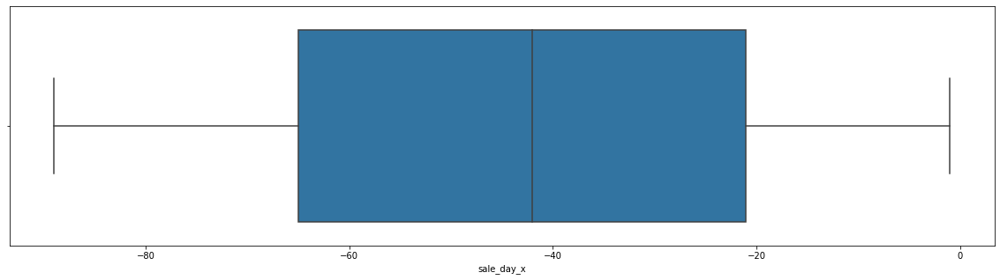

In [78]:
plt.figure(figsize=(20,5))

sns.boxplot(df.sale_day_x)

**Observations** Répartition assez uniforme des valeurs avec des puits sur des valeurs spécifiques (à explorer pour créer des intérvales). Cette colonne contient des valeurs entières donc il peut s'avérer profitable de la considérer comme une colonne qualitative et la mettre en intervals. Mais cela reste à identifier. Il faut tenir en compte que cela revient à perdre des données. On va utiliser les valeurs dans la consigne pour créer une colonne qualitative

In [79]:
df["sale_day_interval"] = pd.cut(df.sale_day_x, [-90, -60, -30,-20,-15,-10,-7,-6,-5,-3,-2,-1])

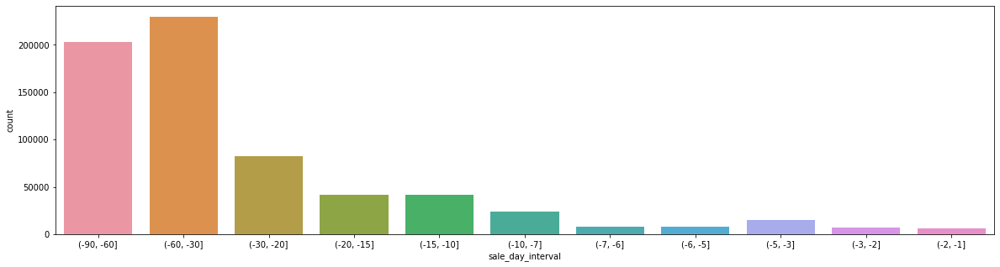

In [80]:
plt.figure(figsize=(20,5))

sns.countplot(df.sale_day_interval)

#### Colonne od_travel_time_minutes

In [81]:
df.od_travel_time_minutes.describe()

count    665406.000000
mean        119.731564
std          89.182864
min          27.000000
25%          34.000000
50%         127.000000
75%         199.000000
max         302.000000
Name: od_travel_time_minutes, dtype: float64

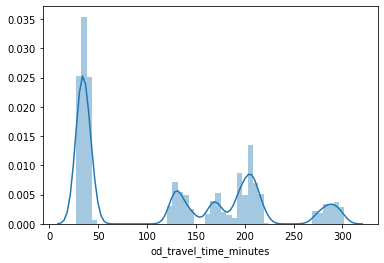

In [82]:
sns.distplot(df.od_travel_time_minutes)

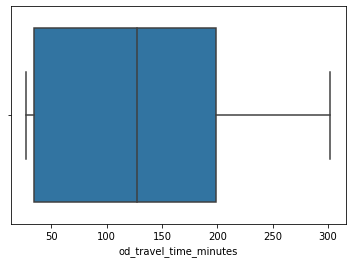

In [83]:
sns.boxplot(df.od_travel_time_minutes)

**Observations** Notons une séparation des données assez évidente au niveau de la distribution. On peut imaginer l'utilisation d'une variable catégorique pour distinguer les trajets courts, moyens et longs

In [84]:
df["tarvel_time_interval"] = pd.cut(df.od_travel_time_minutes, [0, 50,150,250,400])

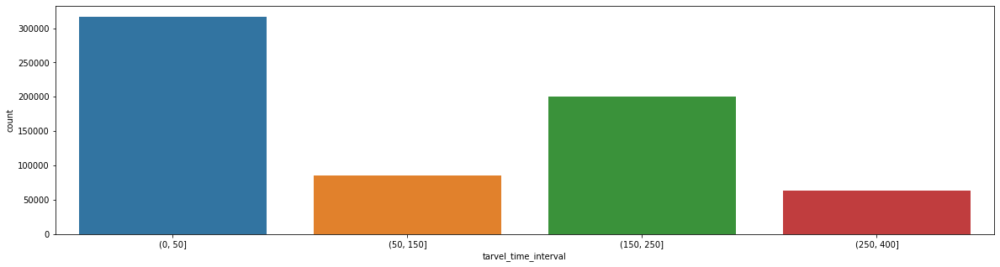

In [85]:
plt.figure(figsize=(20,5))

sns.countplot(df.tarvel_time_interval)

Les trajets courts resten les plus fréquents

#### Colonne price

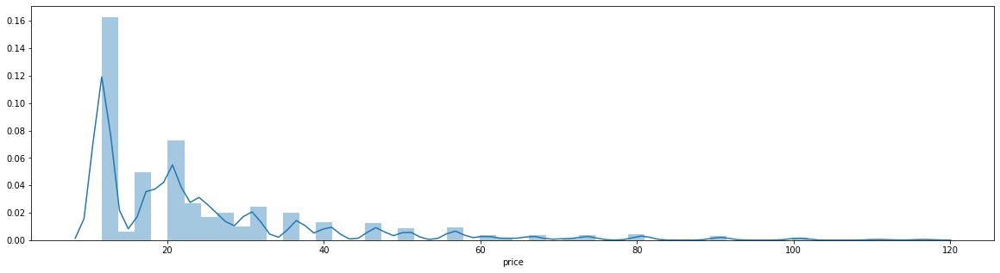

In [86]:
plt.figure(figsize=(20,5))
sns.distplot(df.price)

count    665406.000000
mean         24.474385
std          16.717205
min          11.650000
25%          11.650000
50%          20.650000
75%          29.650000
max         116.650000
Name: price, dtype: float64

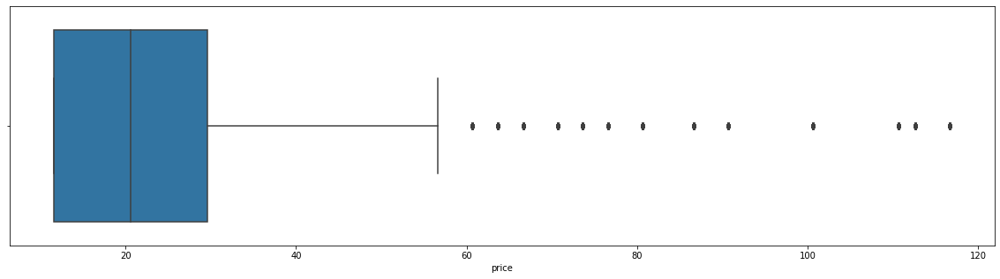

In [87]:
plt.figure(figsize=(20,5))
sns.boxplot(df.price)
df.price.describe()

**Observation** Regroupement de la majorité des valeurs dans l'interval entre 0 et 30 avec plusieurs valeurs abérantes. Il faut rester prudent en traitant cette colonne et essayer de l'expliquer au mieux par sa relation avec les autres pendant l'analyse bi variée

#### colonne sale_date

In [88]:
df.sale_date.describe()

count         665406
unique           675
top       2020-07-25
freq            2340
Name: sale_date, dtype: object

**Observations** Peut être remplacée par les autres colonnes détaillées. il vaut mieux la supprimer

In [89]:
df = df.drop(["sale_date"], axis=1)

 #### Colonne sale_day

In [90]:
df.sale_day.describe()

count    665406.000000
mean         15.823608
std           8.789449
min           1.000000
25%           8.000000
50%          16.000000
75%          23.000000
max          31.000000
Name: sale_day, dtype: float64

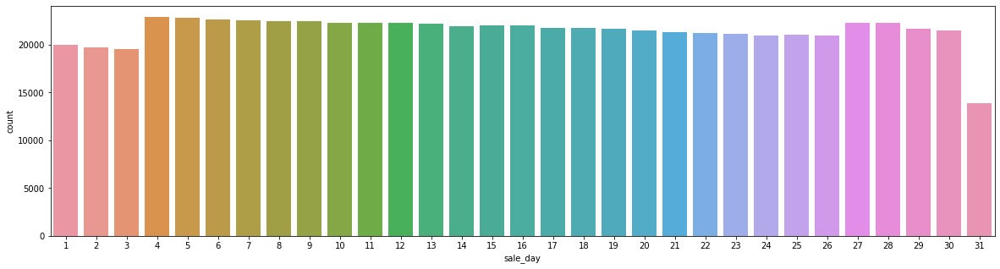

In [91]:
plt.figure(figsize=(20,5))
sns.countplot(df.sale_day)

**Observations** Données bien réparties, seraient plus utiles pour détecter les fins de mois

  0%|          | 0/665406 [00:00<?, ?it/s]

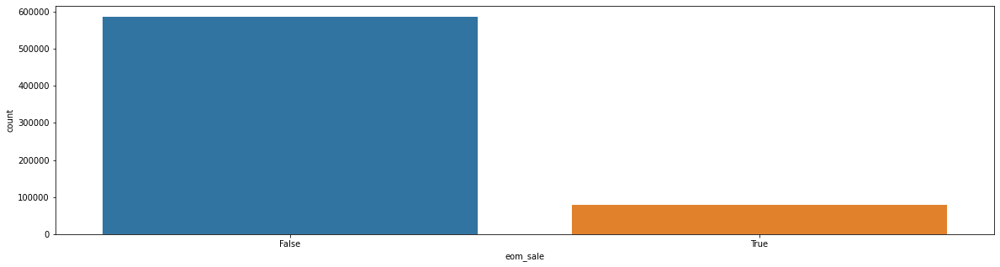

In [92]:
df["eom_sale"] = df.progress_apply(lambda x: x.sale_day>=28,axis=1)
plt.figure(figsize=(20,5))
sns.countplot(df.eom_sale)

In [93]:
print(f"Ventes en fin de mois représentent {df[df.eom_sale].shape[0]*100/df.shape[0]}%")

Ventes en fin de mois représentent 11.935870731553367%


 #### Colonne sale_week

In [94]:
df.sale_week.describe()

count    665406.000000
mean          3.022477
std           2.008513
min           0.000000
25%           1.000000
50%           3.000000
75%           5.000000
max           6.000000
Name: sale_week, dtype: float64

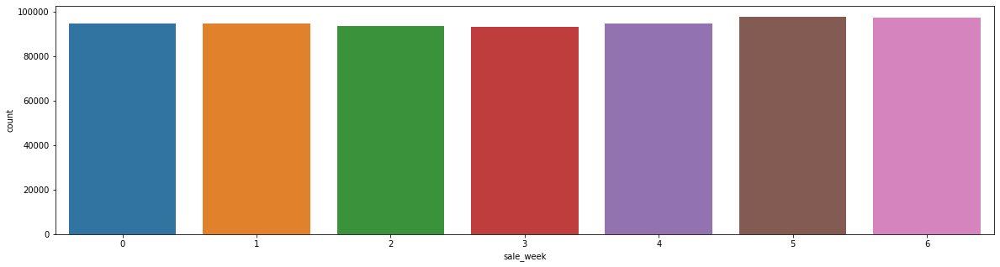

In [95]:
plt.figure(figsize=(20,5))
sns.countplot(df.sale_week)

Ceci est très étrange : Cette colonne semble contenir les jours de vente et non les semaines

In [96]:
df[df.progress_apply(lambda x: x.sale_week!=x.sale_weekday, axis=1)]

  0%|          | 0/665406 [00:00<?, ?it/s]

,dataset_type,demand,destination_current_school_holiday,destination_days_to_next_school_holiday,destination_station_name,od_destination_time,od_number_of_similar_12_hours,od_number_of_similar_2_hours,od_number_of_similar_4_hours,od_origin_month,...,sale_year,departure_day_of_month,track_stations,night_origin,night_destination,is_week_end,is_eom_track,sale_day_interval,tarvel_time_interval,eom_sale


C'est exactement la même colonne que sale_weekday, ils'agit d'une erreur je supprime la colone

In [97]:
df = df.drop(["sale_week"], axis=1)

#### Colonne sale_weekday

In [98]:
df.sale_weekday.describe()

count    665406.000000
mean          3.022477
std           2.008513
min           0.000000
25%           1.000000
50%           3.000000
75%           5.000000
max           6.000000
Name: sale_weekday, dtype: float64

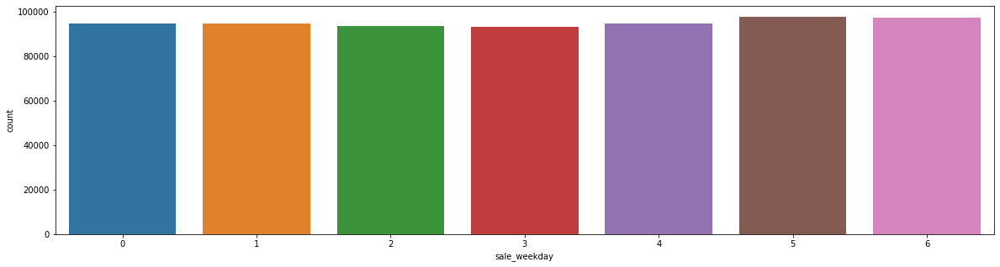

In [99]:
plt.figure(figsize=(20,5))
sns.countplot(df.sale_weekday)

Ventes légérements plus élevées pendant le week end

  0%|          | 0/665406 [00:00<?, ?it/s]

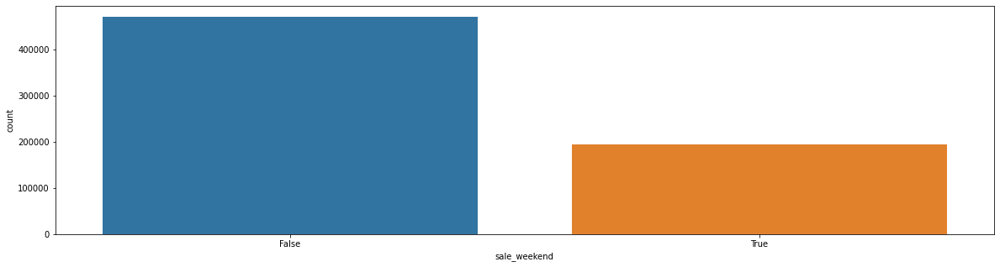

In [100]:
df["sale_weekend"] = df.progress_apply(lambda x: x.sale_weekday>=5,axis=1)
plt.figure(figsize=(20,5))
sns.countplot(df.sale_weekend)

In [101]:
print(f"Pourcentage des ventes de weekend {df[df.sale_weekend].shape[0]*100/df.shape[0]}%")

Pourcentage des ventes de weekend 29.28618016669522%


 #### Colonne sale_month

In [102]:
df.sale_month.describe()

count    665406.000000
mean          6.450445
std           2.814974
min           1.000000
25%           5.000000
50%           7.000000
75%           8.000000
max          12.000000
Name: sale_month, dtype: float64

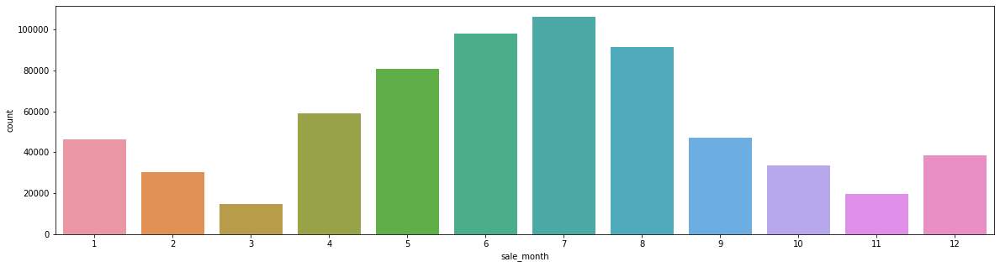

In [103]:
plt.figure(figsize=(20,5))
sns.countplot(df.sale_month)

Ventes plus fortes pendant l'été, puis en période de début et de fin d'année. Ventes plus faible pendant le mois de Mars

 #### Colonne sale_year

In [104]:
df.sale_year.describe()

count    665406.000000
mean       2019.469566
std           0.525622
min        2018.000000
25%        2019.000000
50%        2019.000000
75%        2020.000000
max        2020.000000
Name: sale_year, dtype: float64

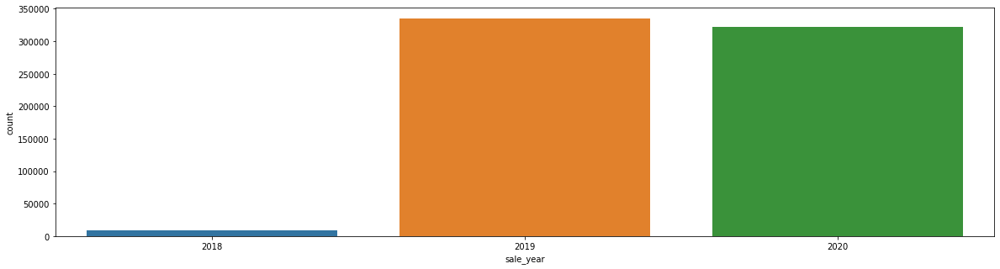

In [105]:
plt.figure(figsize=(20,5))
sns.countplot(df.sale_year)

Données de 2018 très faibles. Elles correspondront forcéments aux ventes pour des trajets de 2019. A voir si cette colonne a une importance. Mais je suis tenté de l'ignorer. Si je fais une ACM 2018 va me rendre la vie difficile

### Analyse bivariée

In [106]:
biv_df = df.copy()

In [107]:
biv_df.columns

Index(['dataset_type', 'demand', 'destination_current_school_holiday',
       'destination_days_to_next_school_holiday', 'destination_station_name',
       'od_destination_time', 'od_number_of_similar_12_hours',
       'od_number_of_similar_2_hours', 'od_number_of_similar_4_hours',
       'od_origin_month', 'od_origin_time', 'od_origin_week',
       'od_origin_weekday', 'od_origin_year', 'od_travel_time_minutes',
       'origin_current_public_holiday', 'origin_current_school_holiday',
       'origin_days_to_next_public_holiday',
       'origin_days_to_next_school_holiday', 'origin_station_name', 'price',
       'sale_day', 'sale_day_x', 'sale_month', 'sale_weekday', 'sale_year',
       'departure_day_of_month', 'track_stations', 'night_origin',
       'night_destination', 'is_week_end', 'is_eom_track', 'sale_day_interval',
       'tarvel_time_interval', 'eom_sale', 'sale_weekend'],
      dtype='object')

In [108]:
cat_columns=['destination_current_school_holiday',
       'destination_station_name',
       'od_origin_month', 'od_origin_week',
       'od_origin_weekday', 'od_origin_year', 
       'origin_current_public_holiday', 'origin_current_school_holiday',
       'origin_station_name', 'sale_day', 'sale_month', 'sale_weekday', 'sale_year',
       'departure_day_of_month', 'track_stations', 'night_origin',
       'night_destination', 'is_week_end', 'is_eom_track', 'sale_day_interval',
       'tarvel_time_interval', 'eom_sale', 'sale_weekend']
quant_columns = ['demand', 'destination_days_to_next_school_holiday', 
       'od_destination_time', 'od_number_of_similar_12_hours',
       'od_number_of_similar_2_hours', 'od_number_of_similar_4_hours',
       'od_origin_time', 'od_travel_time_minutes',
       'origin_days_to_next_public_holiday',
       'origin_days_to_next_school_holiday', 'price', 'sale_day_x']

In [109]:
for col in cat_columns:
    biv_df[col] = biv_df[col].astype("category")

#### Analyse des corrélations

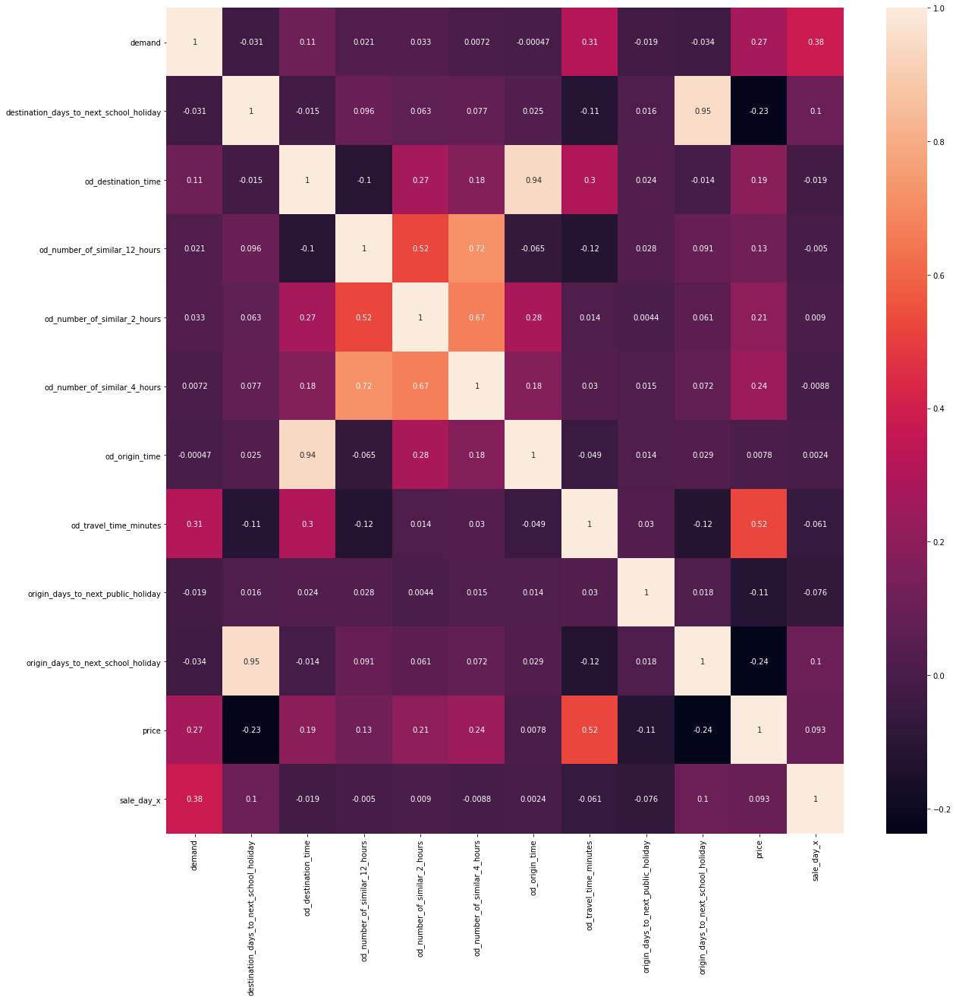

In [110]:
plt.figure(figsize=(20,20))
corr = biv_df[quant_columns].corr()
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
        annot=True)

**Observations**
 - Corrélation moyenne entre le prix et la durée des voyages
 - Corrélation moyenne à faible entre demande et jour de vente, prix et durée
 - Corrélattion faible à très faible entre le prix et la disponibilité des trains
 - Les trains disponibles sont assez corrélés vu qu'ils reprennet les valeurs les unes des autres, donc c'est évident

In [111]:
fact_df=biv_df[cat_columns].apply(lambda x : pd.factorize(x)[0])+1

In [112]:
fact_df["demand"] = biv_df["demand"]

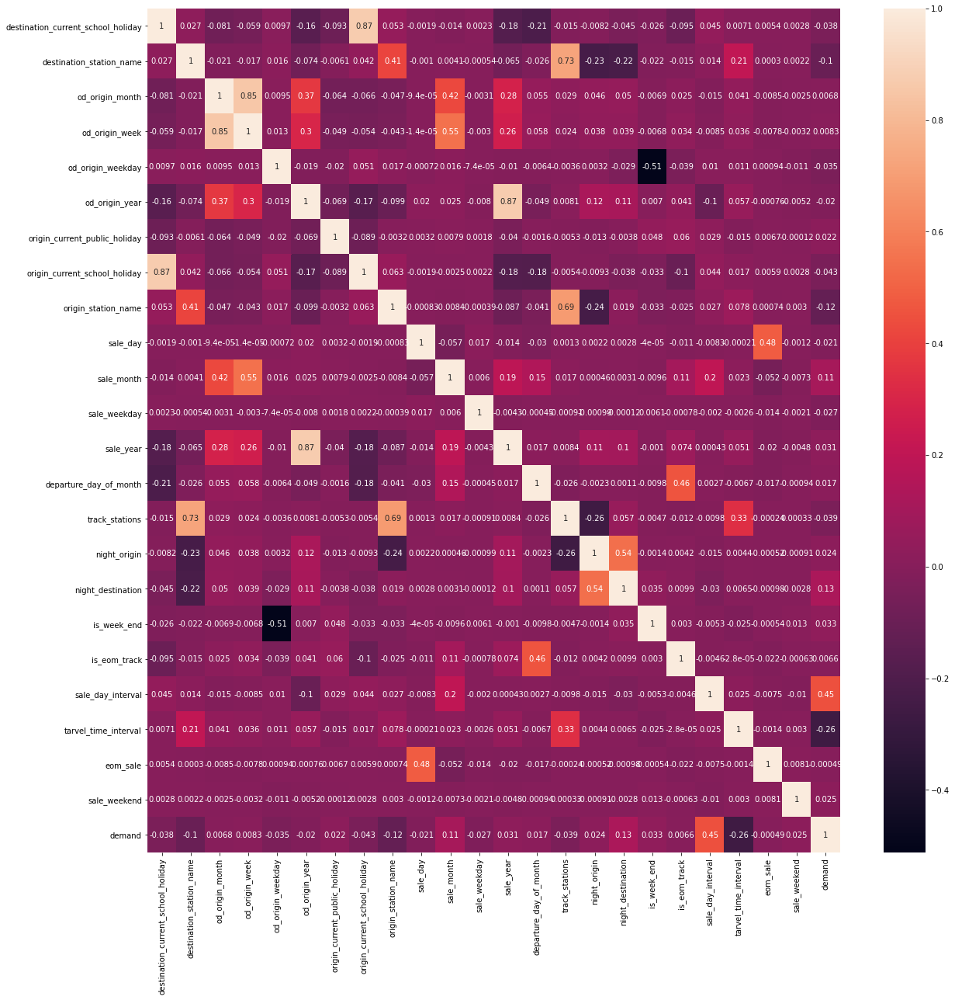

In [113]:
plt.figure(figsize=(20,20))
corr = fact_df.corr(method='pearson', min_periods=1)
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
        annot=True)

**Observations**
 - Les mois et les semaines sont assez corrélées. Les semaines représentent une ganularité plus fine, il vaut mieux supprimer les mois
 - Correlation moyenne entre le mois de vente et la semaine de voyage
 - Les années de commande et de voyage sont assez corrélées, ce qui est naturel, Je ne vois toujours pas de raison de garder l'année
 - Corrélation faible à moyenne entre les durées et les stations (départ arrivé)
 - Corrélation moyenne avec l'inteval de vente

Essayons d'explorer en détails certaines relations entre la demande et les différentes colonnes catégoriques

In [114]:
def detect_dependency(column, data):
    cont_table = pd.crosstab(data[column], data.demand, rownames=[column], colnames=['demand'])
    chi2, p, dof, expected = chi2_contingency(cont_table)
    if p>0.05:
        print(f"column {column} chi2 : {chi2}, P-Value : {p}")
    return p

def analyse_features(columns):
    relevant_columns = []
    for column in columns:
        p = detect_dependency(column, biv_df)
        if p<0.05:
            relevant_columns.append(column)
    return relevant_columns
    
def relevant_columns_analysis(columns):
    subdf = biv_df[columns+['demand', 'price', 'sale_day_x']].groupby(columns).agg({
        'demand': ['sum', 'mean'],
        'price': ['sum', 'mean'],
        'sale_day_x': ['sum', 'mean'],
    })
    return subdf

In [115]:
analyse_features(cat_columns)

column eom_sale chi2 : 139.21143497824343, P-Value : 0.3613281986798681


['destination_current_school_holiday',
 'destination_station_name',
 'od_origin_month',
 'od_origin_week',
 'od_origin_weekday',
 'od_origin_year',
 'origin_current_public_holiday',
 'origin_current_school_holiday',
 'origin_station_name',
 'sale_day',
 'sale_month',
 'sale_weekday',
 'sale_year',
 'departure_day_of_month',
 'track_stations',
 'night_origin',
 'night_destination',
 'is_week_end',
 'is_eom_track',
 'sale_day_interval',
 'tarvel_time_interval',
 'sale_weekend']

In [116]:
relevant_columns_analysis(['is_eom_track', 'sale_weekend', 'is_week_end'])

demand                   price  \
                                          sum      mean           sum   
is_eom_track sale_weekend is_week_end                                   
False        False        False        924373  2.975648  6.750816e+06   
                          True         384009  3.529981  3.415596e+06   
             True         False        335680  2.566753  2.875728e+06   
                          True         135803  3.169709  1.371632e+06   
True         False        False        118116  3.140882  8.971339e+05   
                          True          48307  3.579092  4.198721e+05   
             True         False         45150  2.831786  3.857626e+05   
                          True          16697  3.148002  1.688626e+05   

                                                 sale_day_x             
                                            mean        sum       mean  
is_eom_track sale_weekend is_week_end                                   
False        False        False        21.731540  -13456852 -43.318929  
                          True         31.397677   -4741546 -43.586395  
             True         False        21.989050   -5631416 -43.060223  
                          True         32.014555   -1832567 -42.773014  
True         False        False        23.856137   -1626298 -43.245705  
                          True         31.108546    -601907 -44.595614  
             True         False        24.194844    -683446 -42.865404  
                          True         31.836840    -232235 -43.784879

In [117]:
cat_columns

['destination_current_school_holiday',
 'destination_station_name',
 'od_origin_month',
 'od_origin_week',
 'od_origin_weekday',
 'od_origin_year',
 'origin_current_public_holiday',
 'origin_current_school_holiday',
 'origin_station_name',
 'sale_day',
 'sale_month',
 'sale_weekday',
 'sale_year',
 'departure_day_of_month',
 'track_stations',
 'night_origin',
 'night_destination',
 'is_week_end',
 'is_eom_track',
 'sale_day_interval',
 'tarvel_time_interval',
 'eom_sale',
 'sale_weekend']

In [118]:
df.demand.describe()

count    665406.000000
mean          3.017909
std           7.282832
min           0.000000
25%           0.000000
50%           0.000000
75%           3.000000
max         192.000000
Name: demand, dtype: float64

## Multivariate analysis

### PCA

In [119]:

pca_df = df[quant_columns].copy()
pca_df['demand_interval'] = pd.cut(df.demand, [-1, 3, 50, 90, 200])
feature_names = [c for c in quant_columns if c!="demand"]

X = StandardScaler().fit_transform(pca_df[feature_names])

n_components = 6
pca = PCA(n_components=n_components)
reduced = pca.fit_transform(X)

for i in range(0, n_components):
    pca_df['PC' + str(i + 1)] = reduced[:, i]

display(pca_df.head())


,demand,destination_days_to_next_school_holiday,od_destination_time,od_number_of_similar_12_hours,od_number_of_similar_2_hours,od_number_of_similar_4_hours,od_origin_time,od_travel_time_minutes,origin_days_to_next_public_holiday,origin_days_to_next_school_holiday,price,sale_day_x,demand_interval,PC1,PC2,PC3,PC4,PC5,PC6
0,1,-13,1088,5,1,2,922,166,52,-6,26.65,-89,"(-1, 3]",-0.074284,1.330240,0.711930,-0.700121,1.730397,-0.578662
1,6,-13,1088,5,1,2,922,166,52,-6,26.65,-88,"(3, 50]",-0.073800,1.326761,0.712906,-0.689086,1.706424,-0.550360
2,5,-13,1088,5,1,2,922,166,52,-6,26.65,-87,"(3, 50]",-0.073317,1.323281,0.713883,-0.678051,1.682451,-0.522058
3,0,-13,1088,5,1,2,922,166,52,-6,26.65,-86,"(-1, 3]",-0.072834,1.319801,0.714859,-0.667016,1.658478,-0.493755
4,0,-13,1088,5,1,2,922,166,52,-6,26.65,-85,"(-1, 3]",-0.072350,1.316321,0.715835,-0.655981,1.634505,-0.465453


Text(0, 0.5, 'Explained Variance')

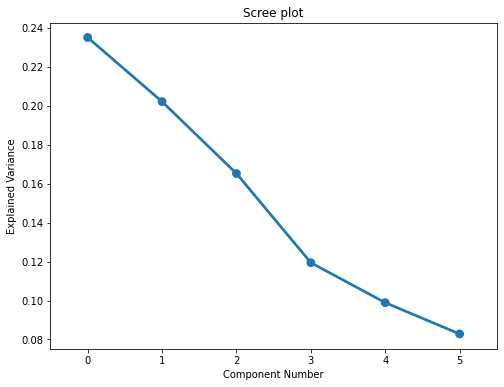

In [120]:
ind = np.arange(0, n_components)
(fig, ax) = plt.subplots(figsize=(8, 6))
sns.pointplot(x=ind, y=pca.explained_variance_ratio_)
ax.set_title('Scree plot')
ax.set_xticks(ind)
ax.set_xticklabels(ind)
ax.set_xlabel('Component Number')
ax.set_ylabel('Explained Variance')




<Figure size 360x360 with 0 Axes>

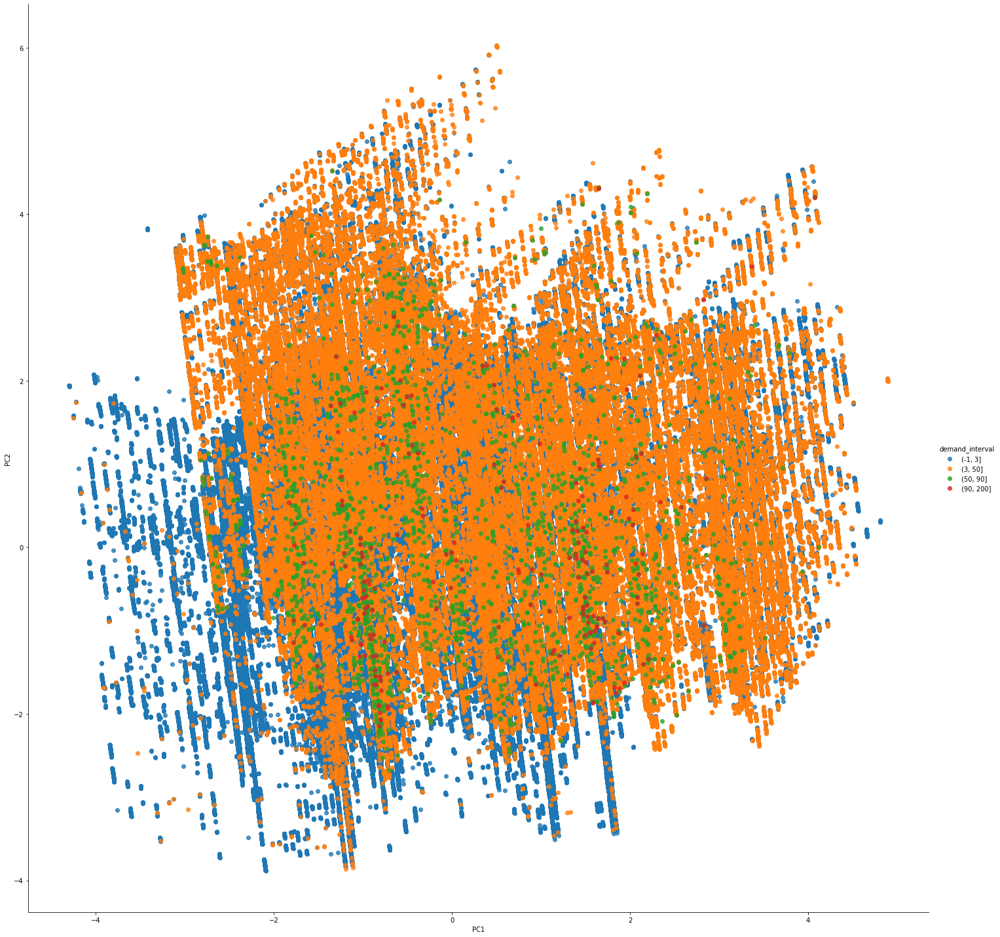

<Figure size 360x360 with 0 Axes>

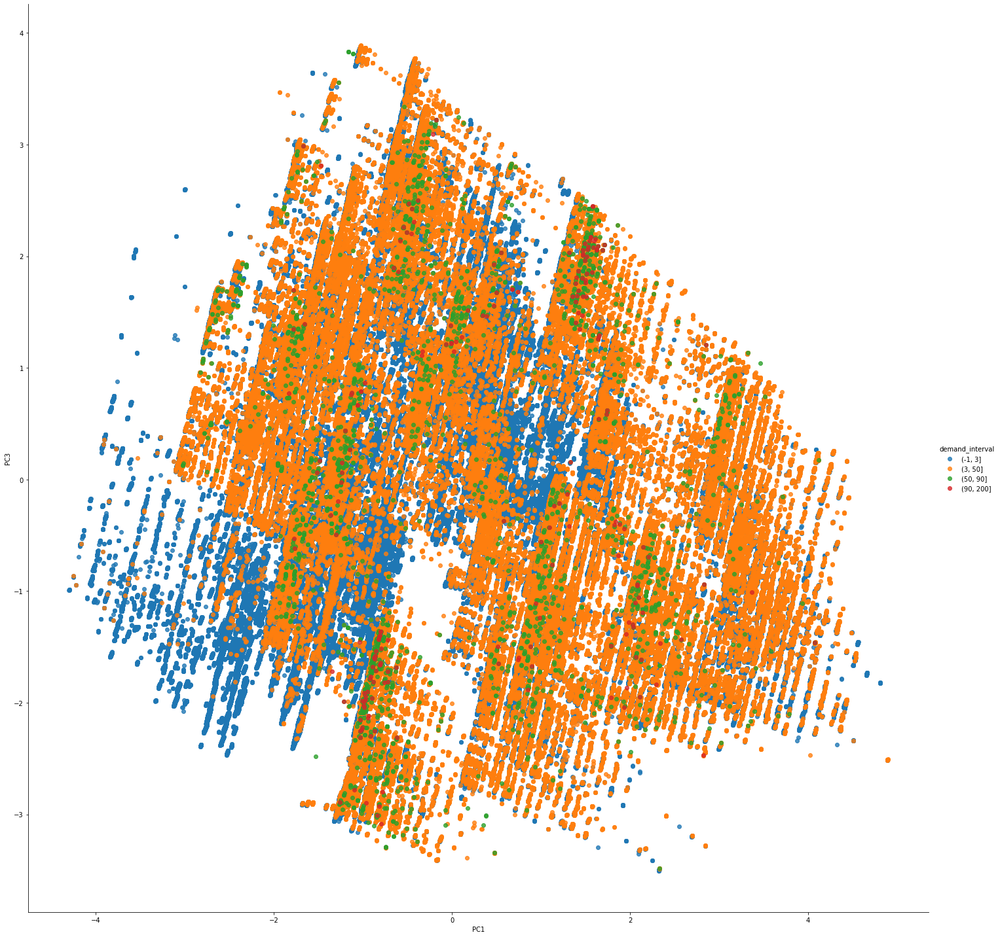

<Figure size 360x360 with 0 Axes>

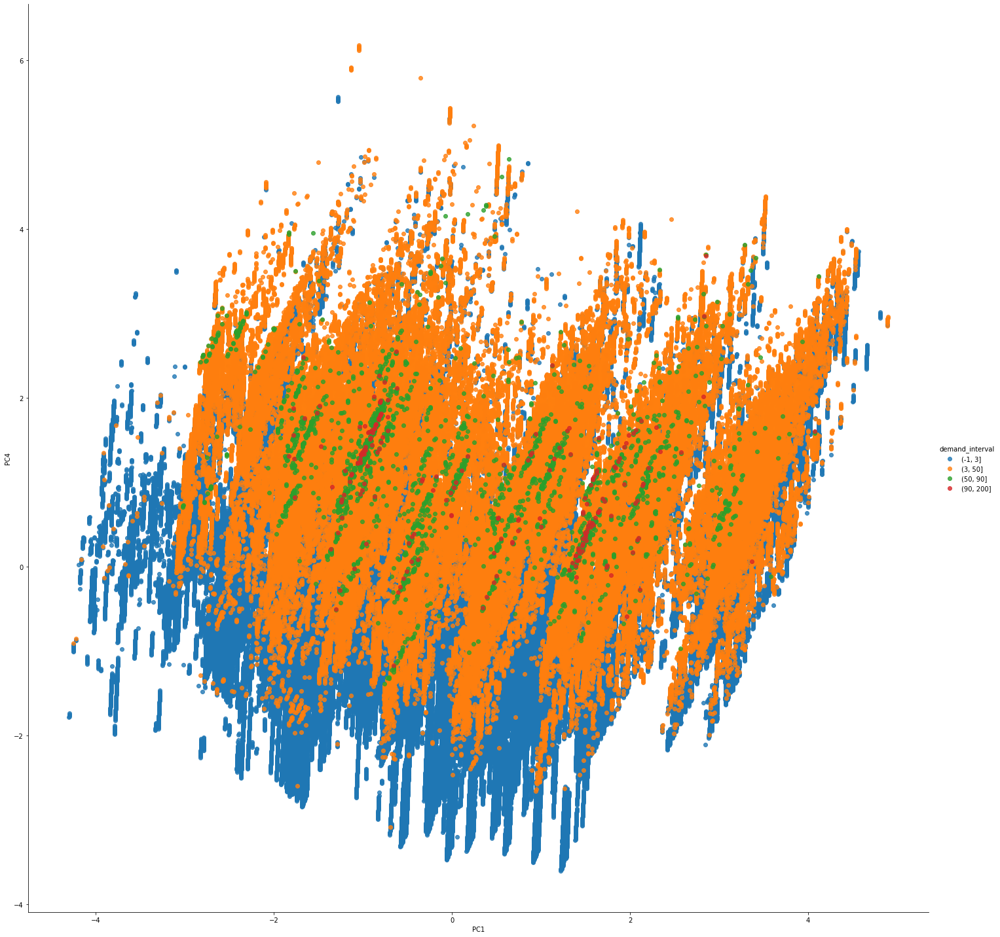

<Figure size 360x360 with 0 Axes>

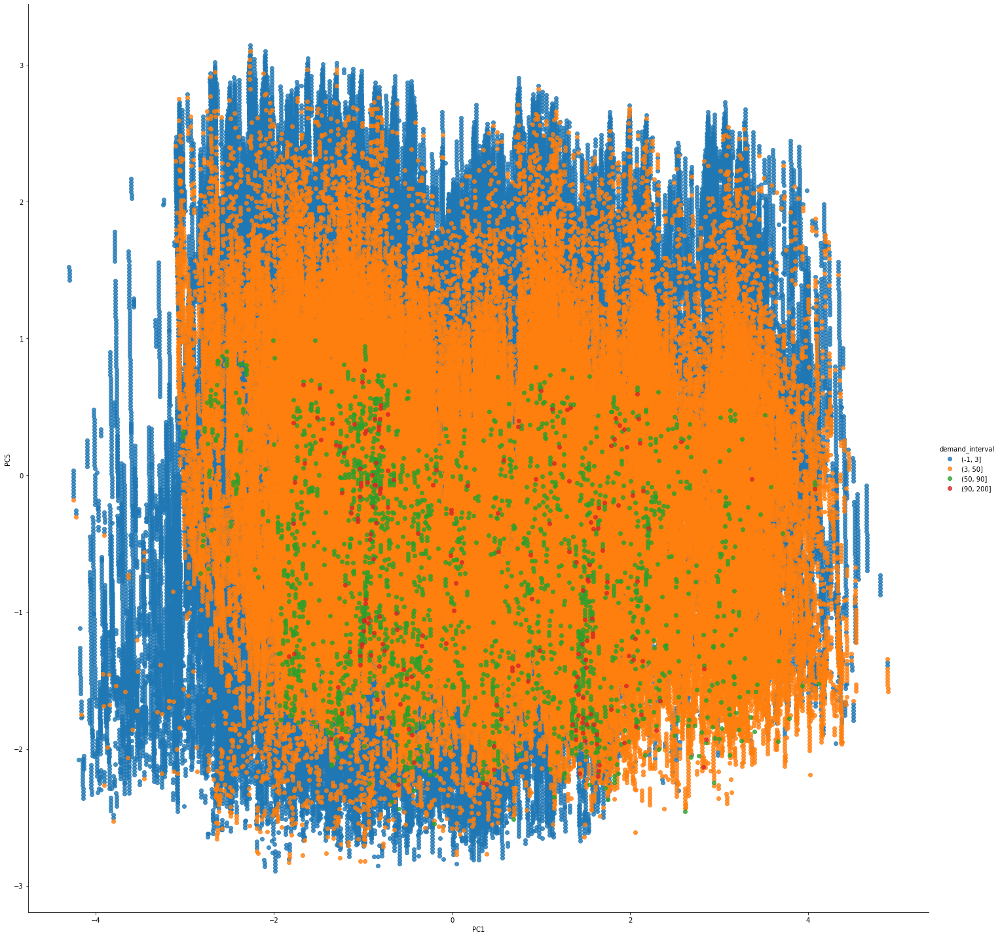

<Figure size 360x360 with 0 Axes>

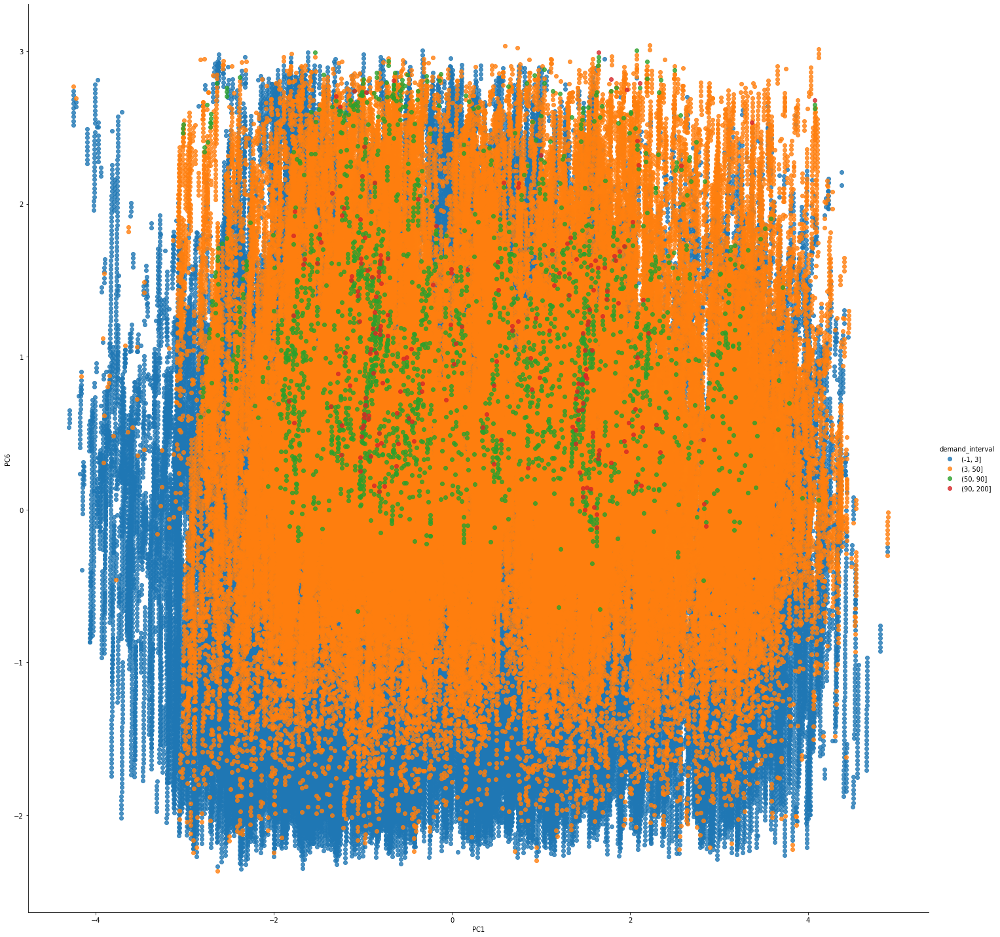

<Figure size 360x360 with 0 Axes>

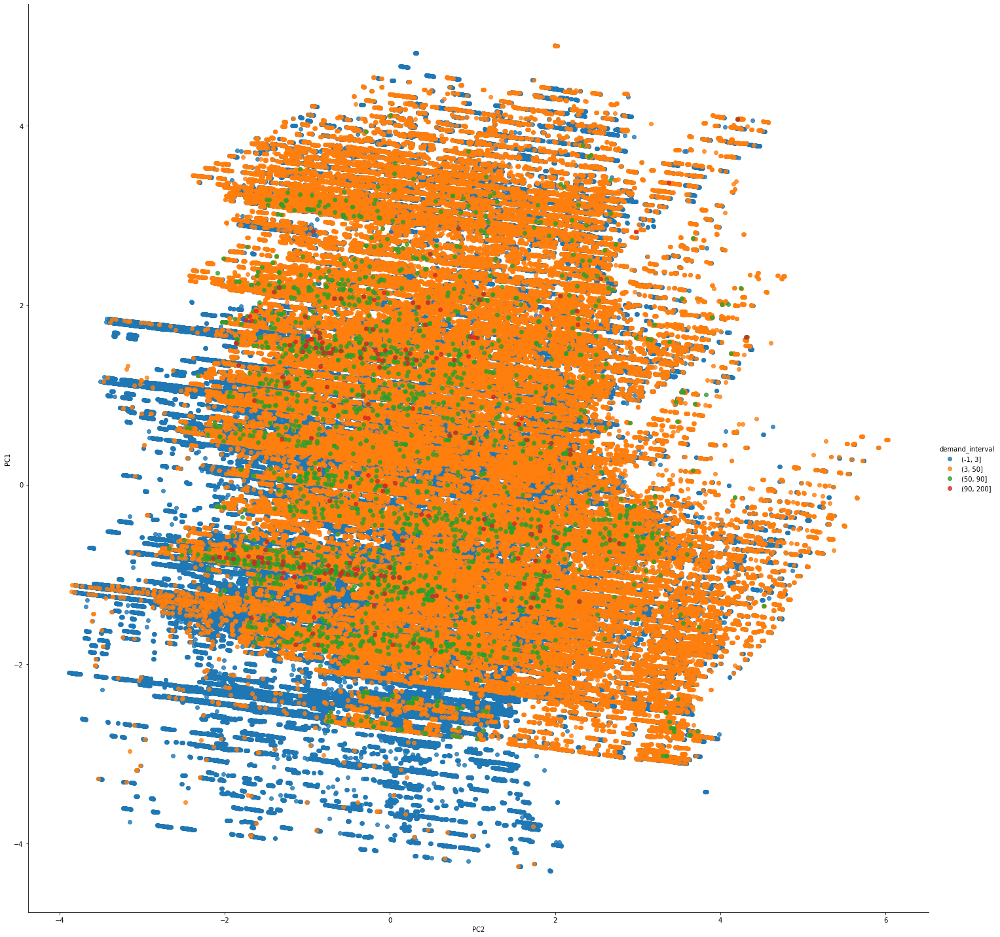

<Figure size 360x360 with 0 Axes>

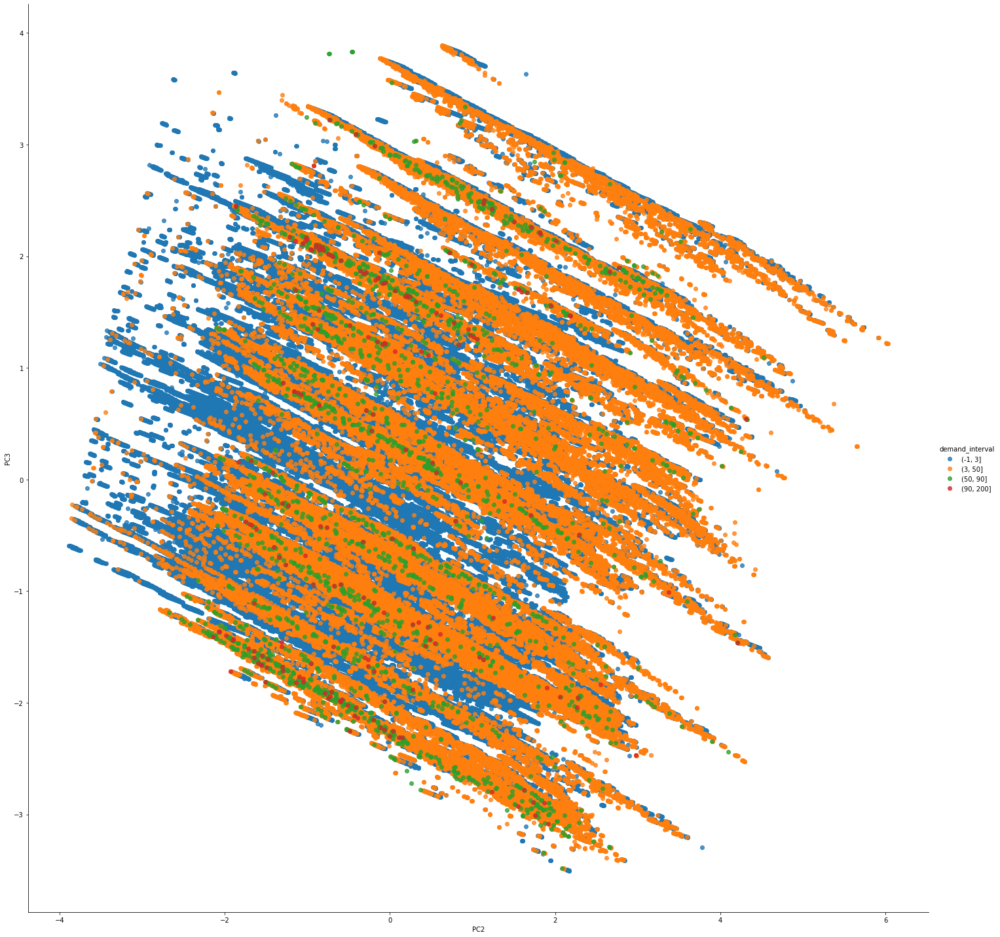

<Figure size 360x360 with 0 Axes>

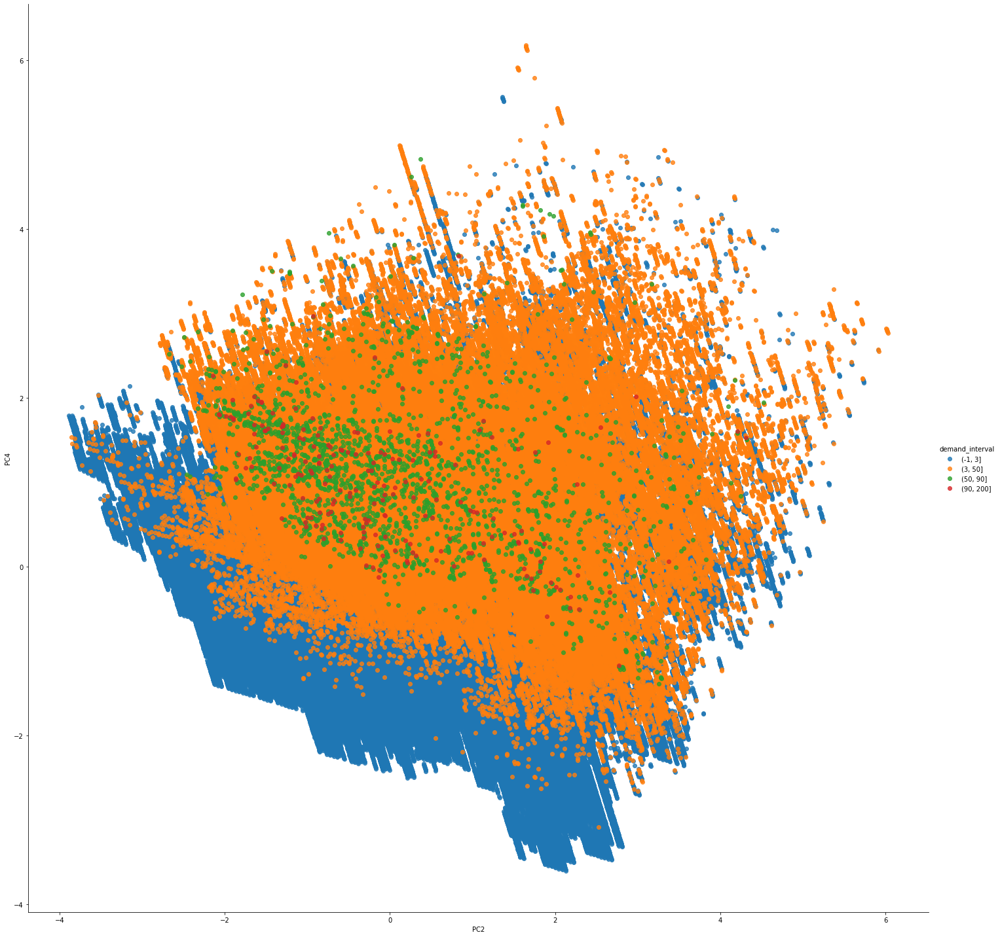

<Figure size 360x360 with 0 Axes>

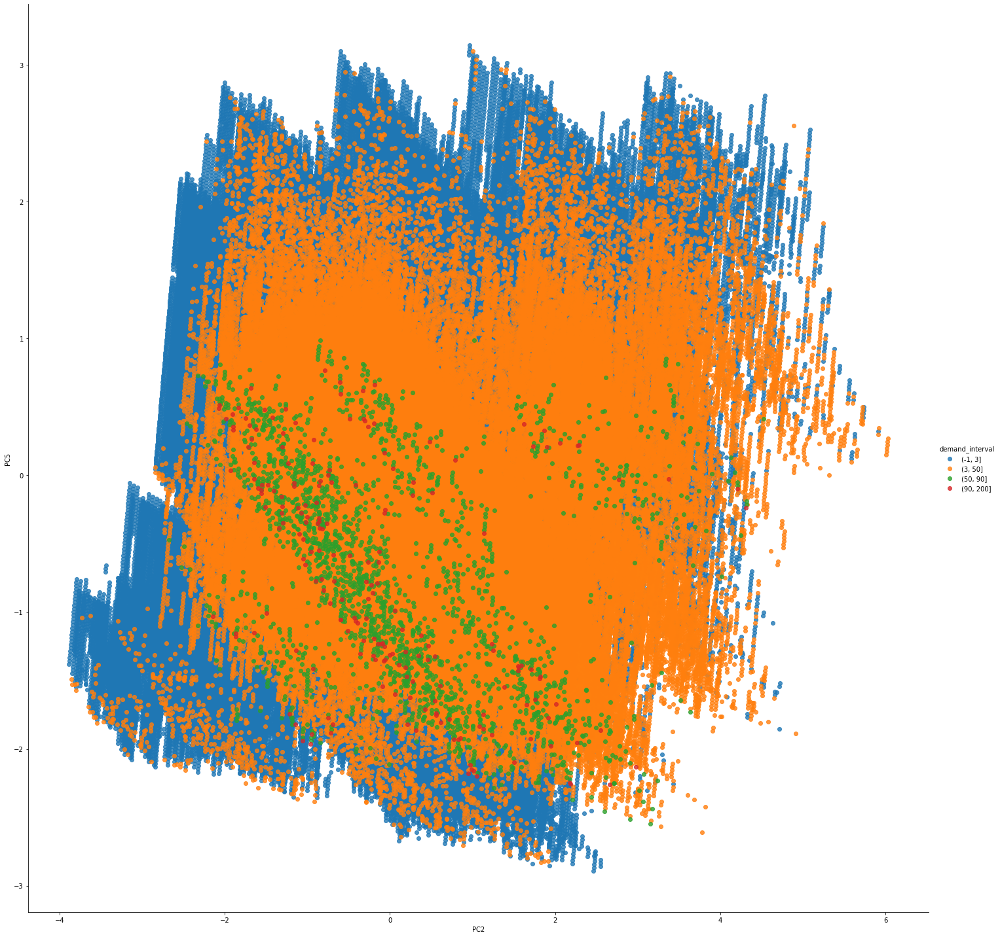

<Figure size 360x360 with 0 Axes>

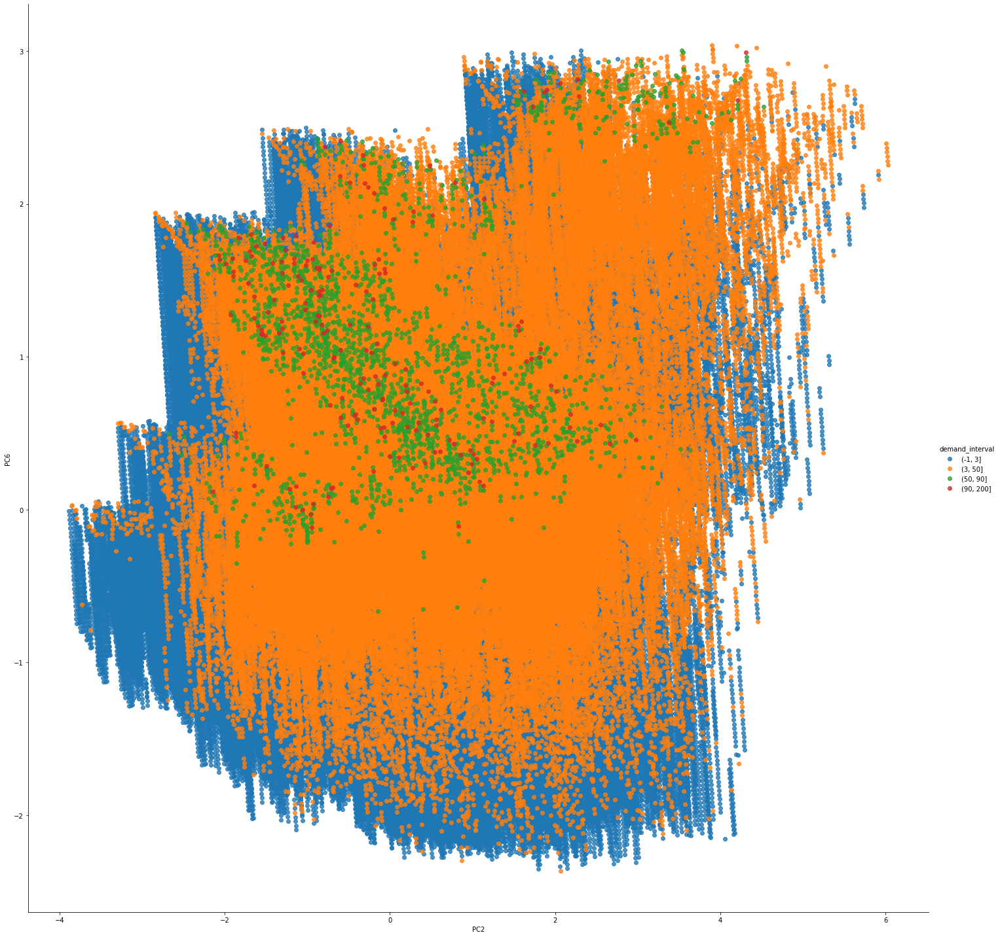

<Figure size 360x360 with 0 Axes>

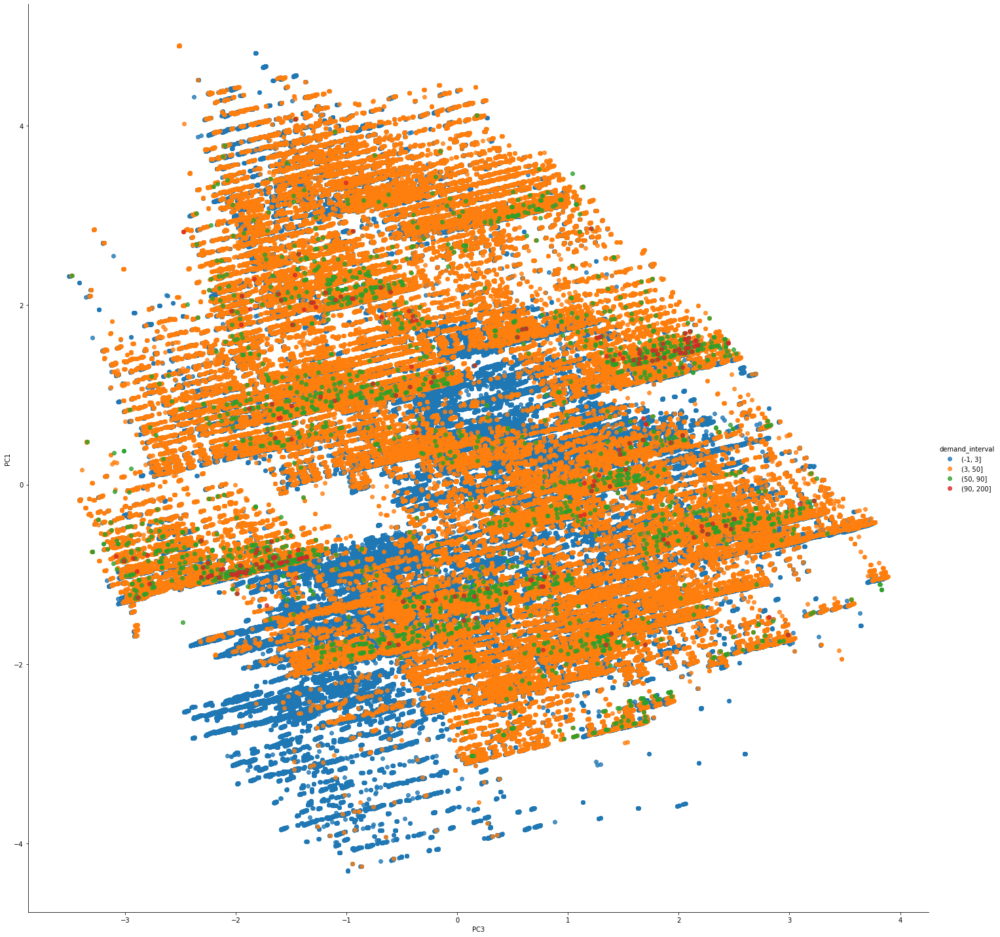

<Figure size 360x360 with 0 Axes>

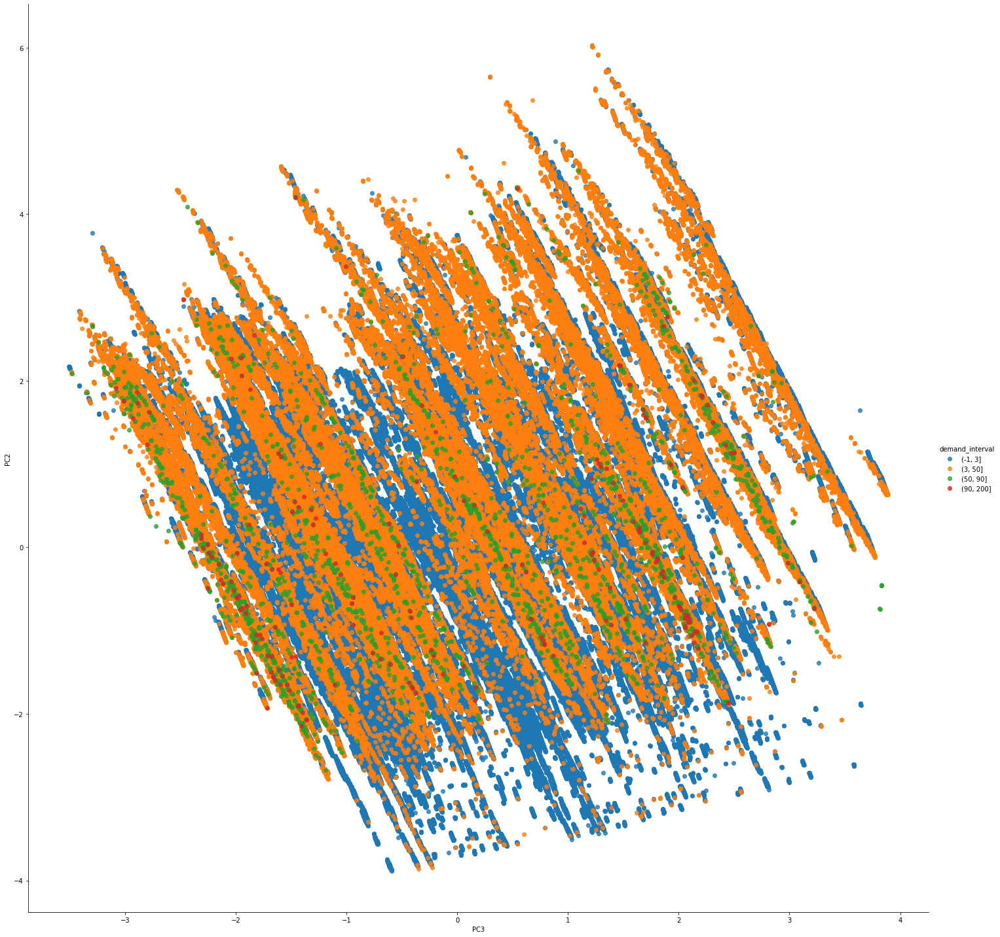

<Figure size 360x360 with 0 Axes>

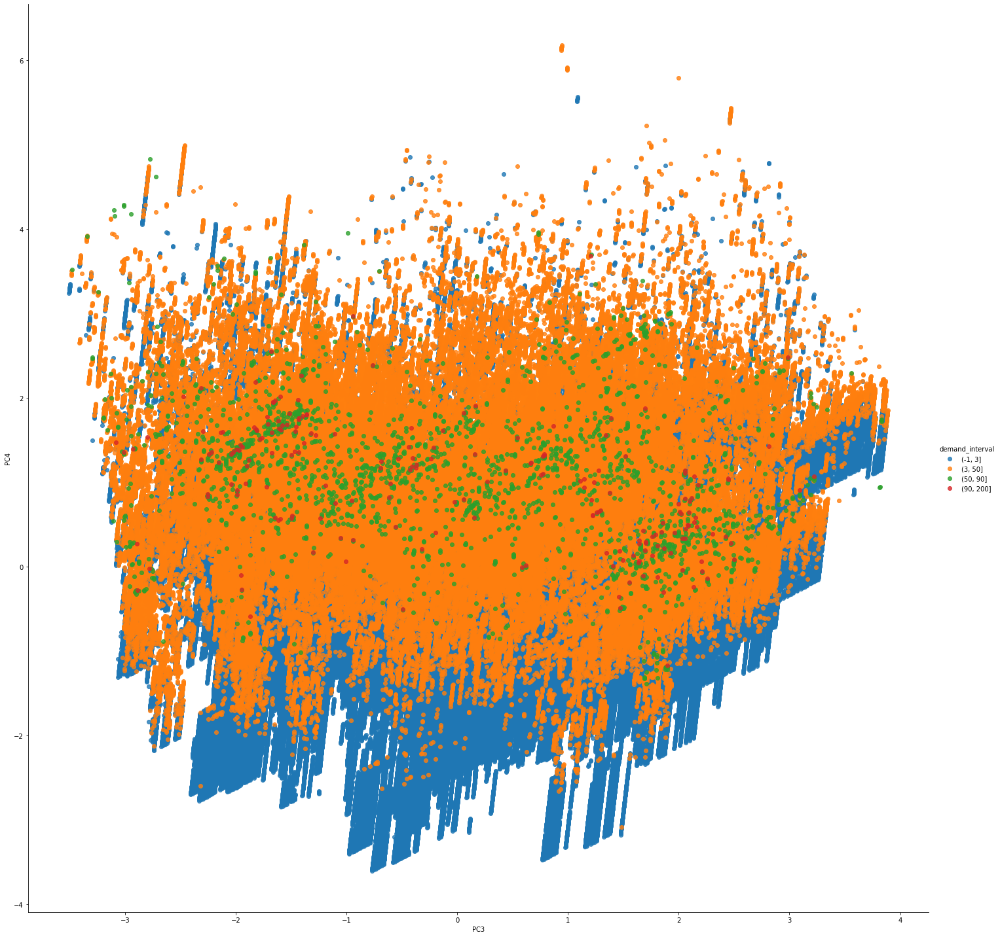

<Figure size 360x360 with 0 Axes>

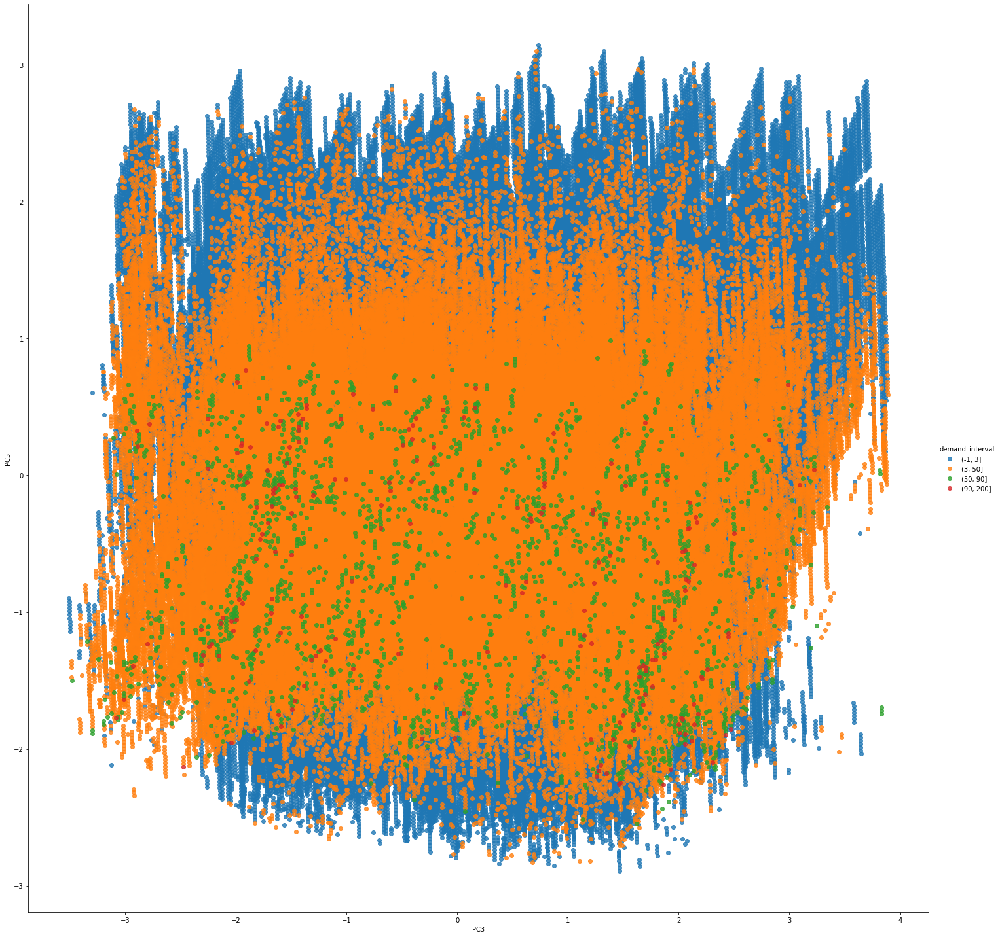

<Figure size 360x360 with 0 Axes>

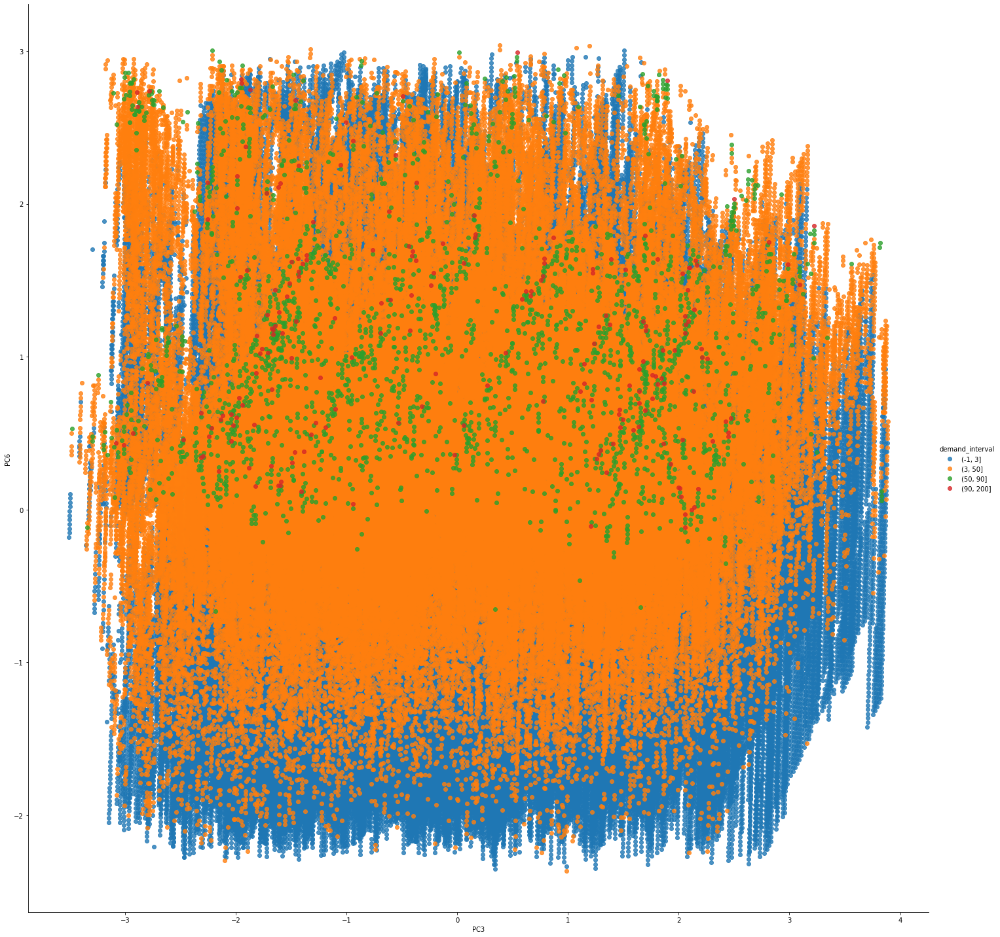

<Figure size 360x360 with 0 Axes>

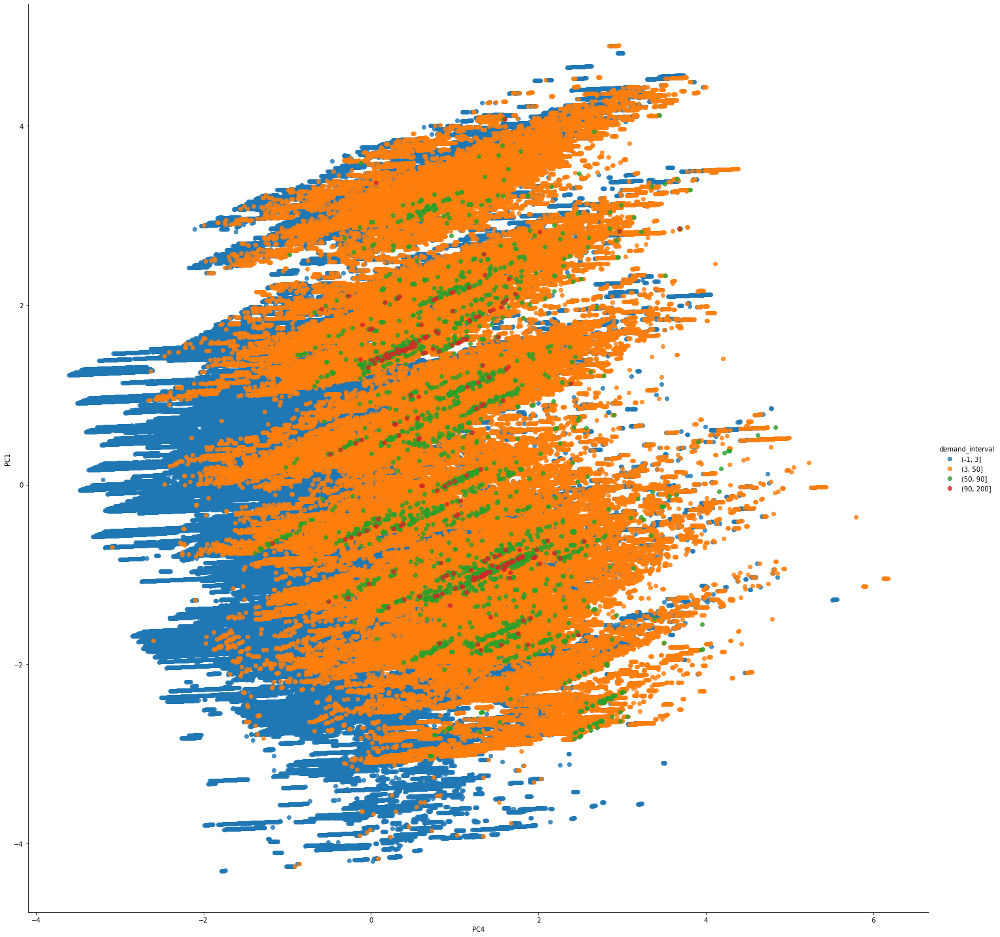

<Figure size 360x360 with 0 Axes>

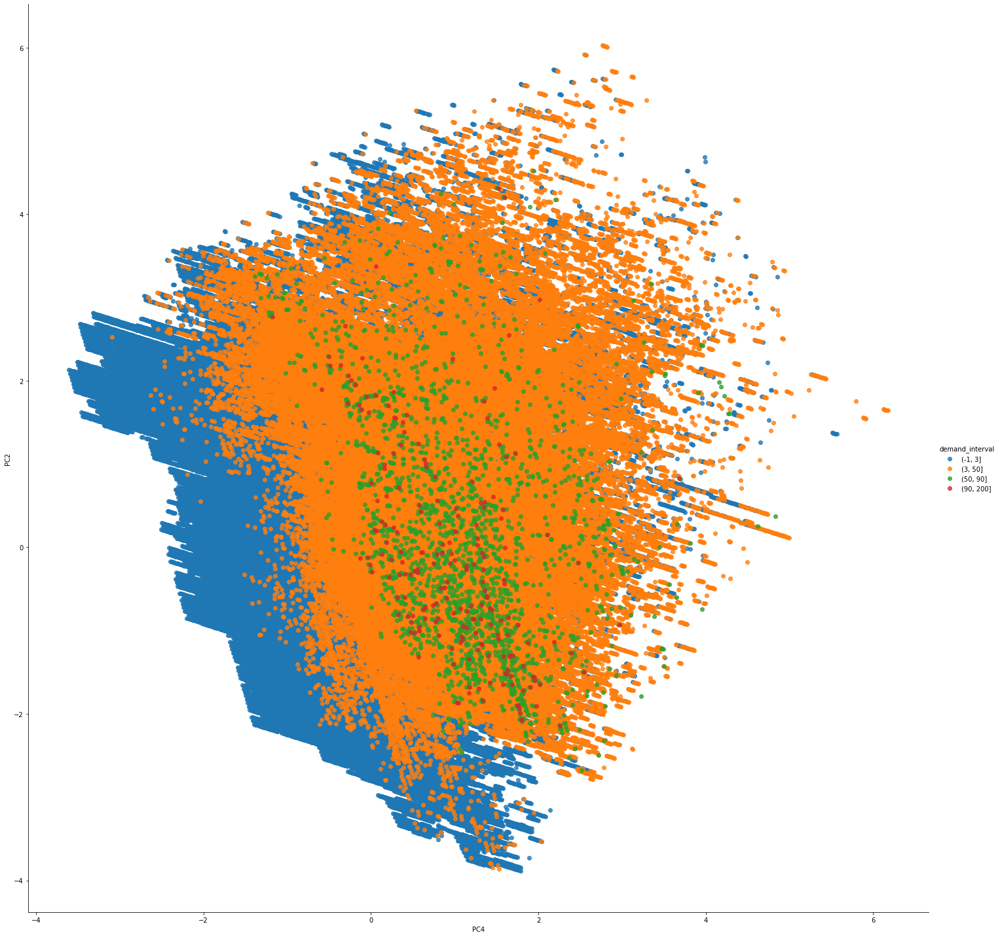

<Figure size 360x360 with 0 Axes>

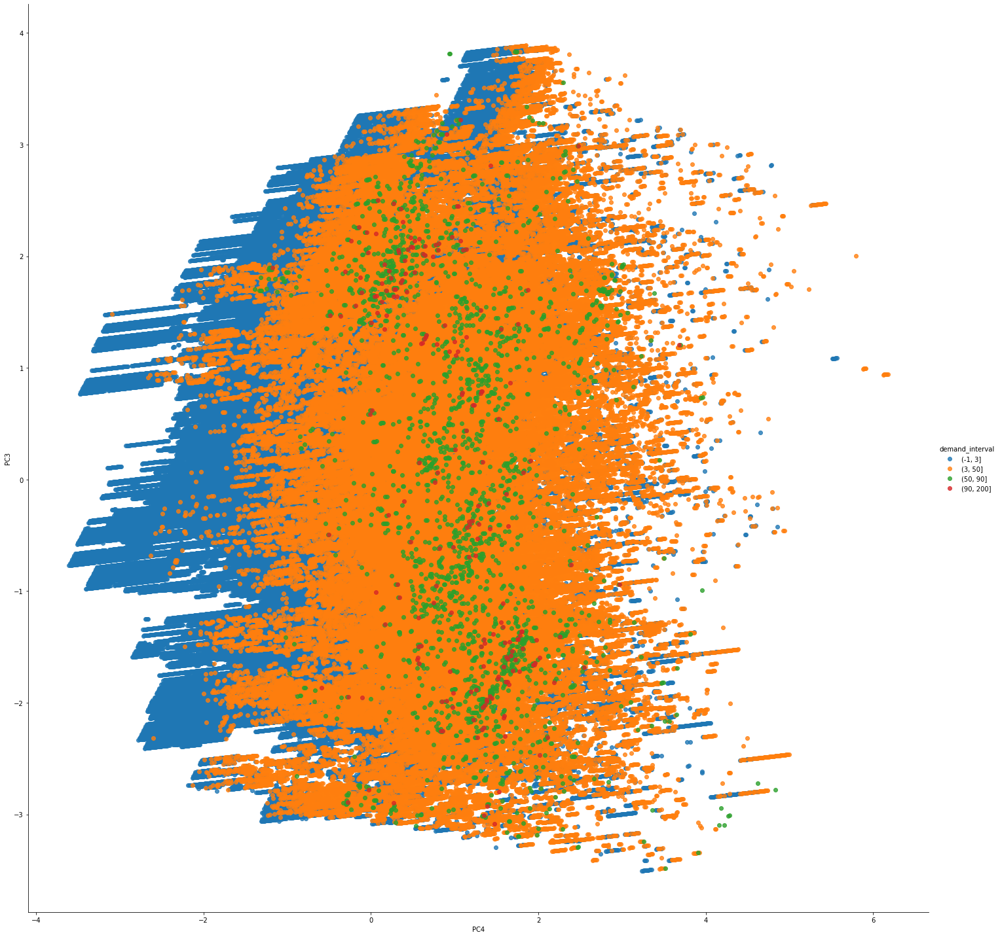

<Figure size 360x360 with 0 Axes>

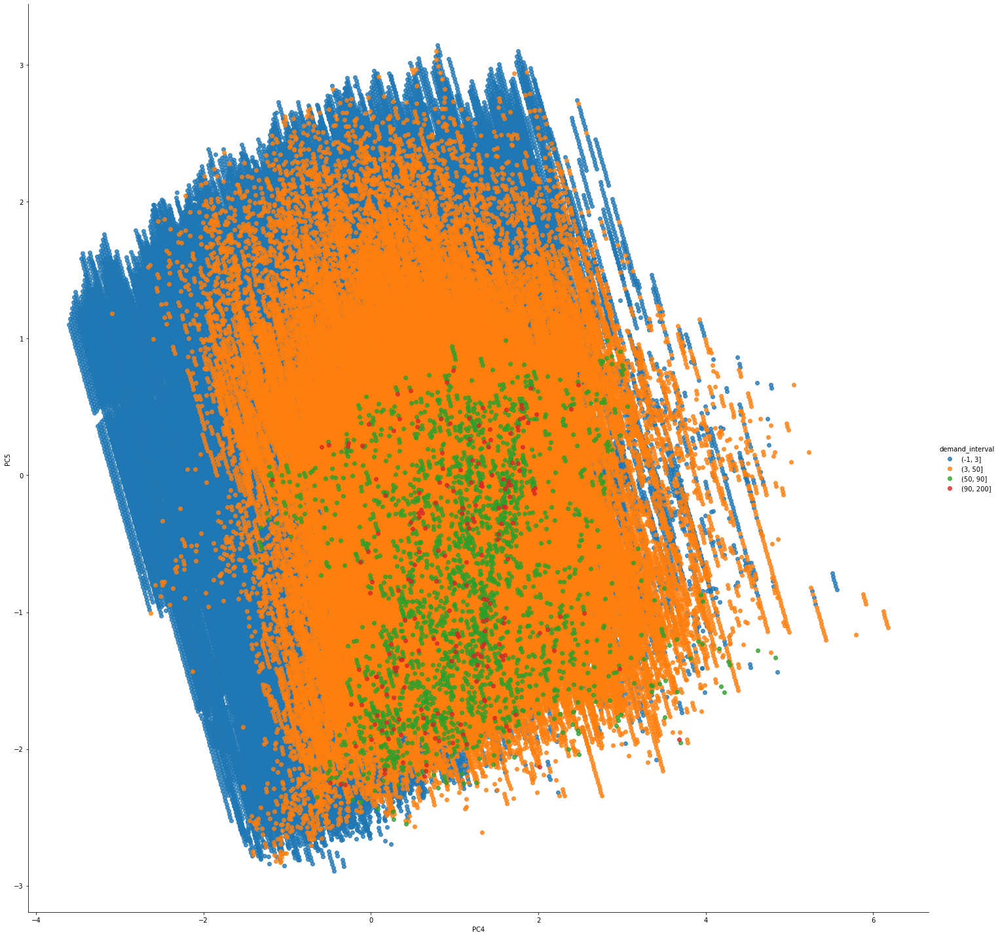

<Figure size 360x360 with 0 Axes>

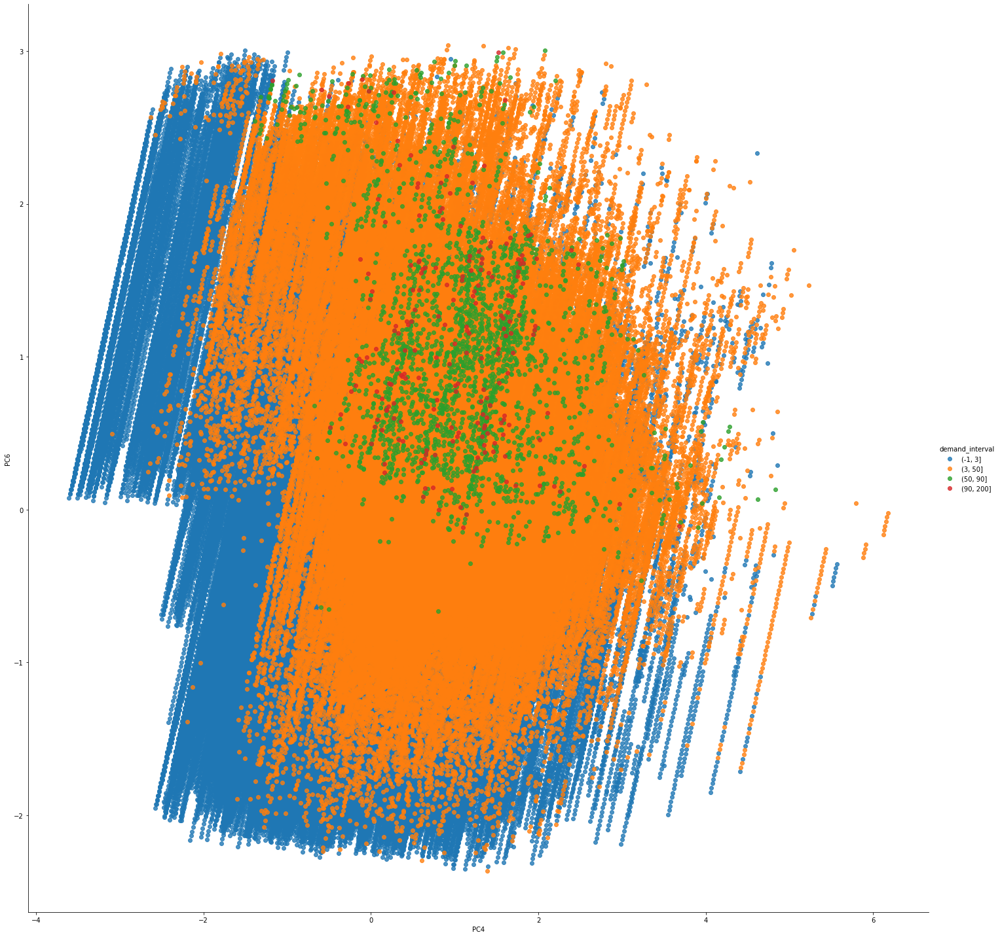

<Figure size 360x360 with 0 Axes>

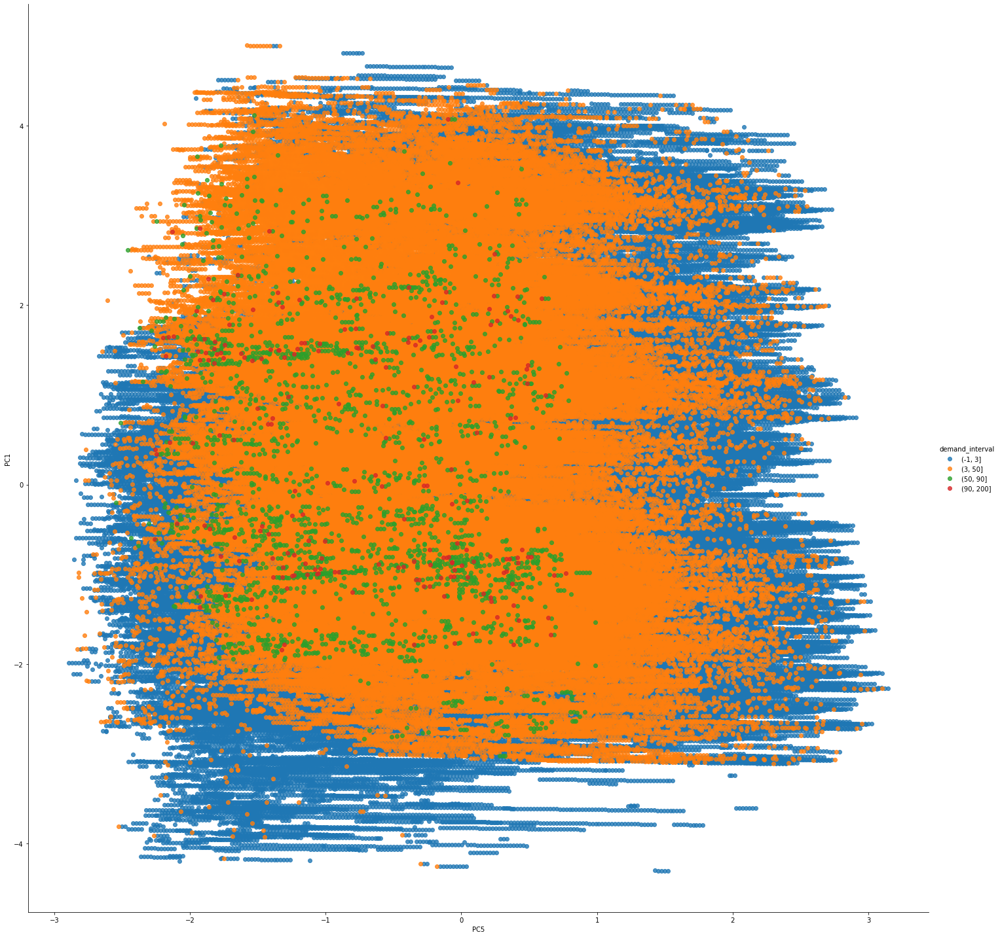

<Figure size 360x360 with 0 Axes>

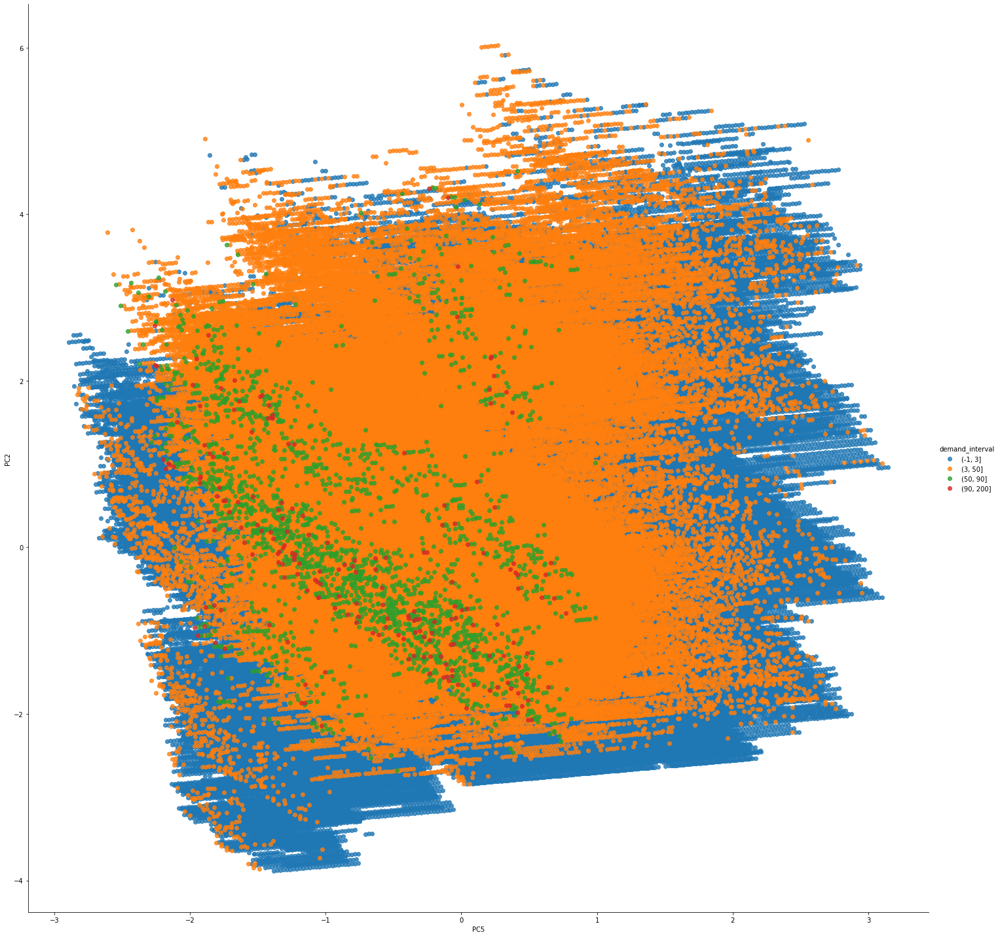

<Figure size 360x360 with 0 Axes>

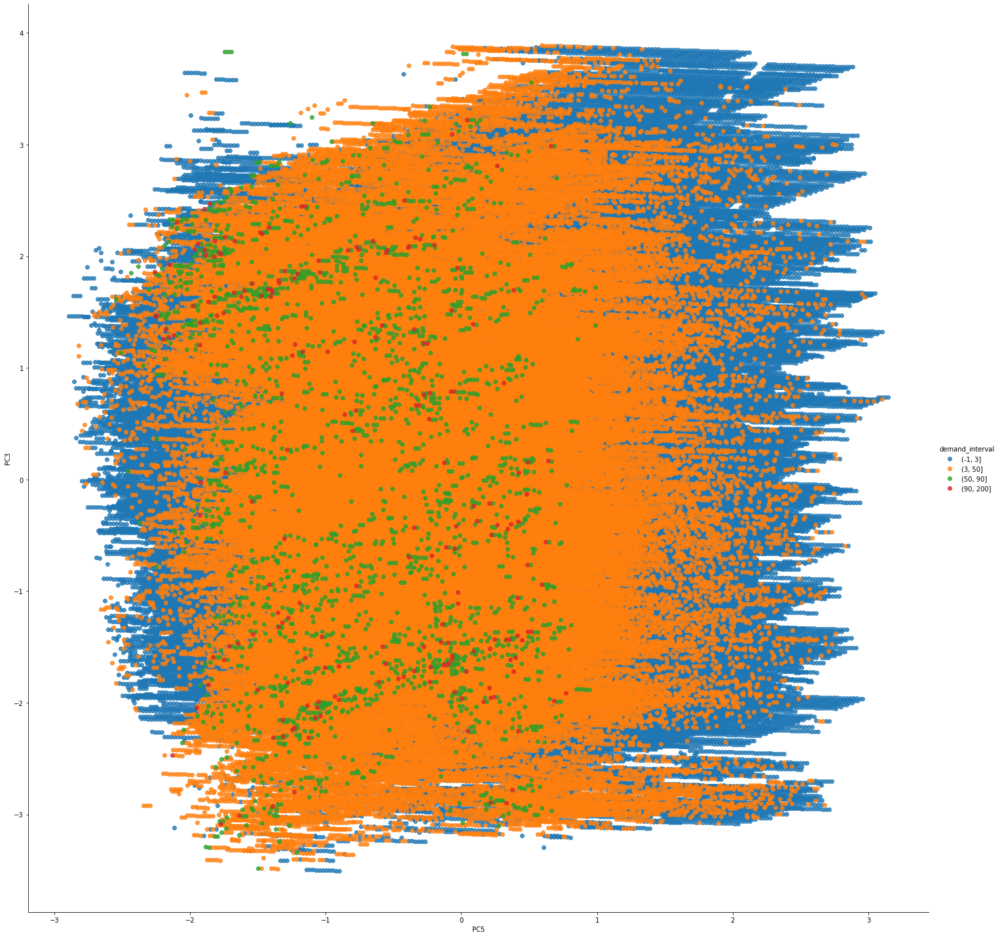

<Figure size 360x360 with 0 Axes>

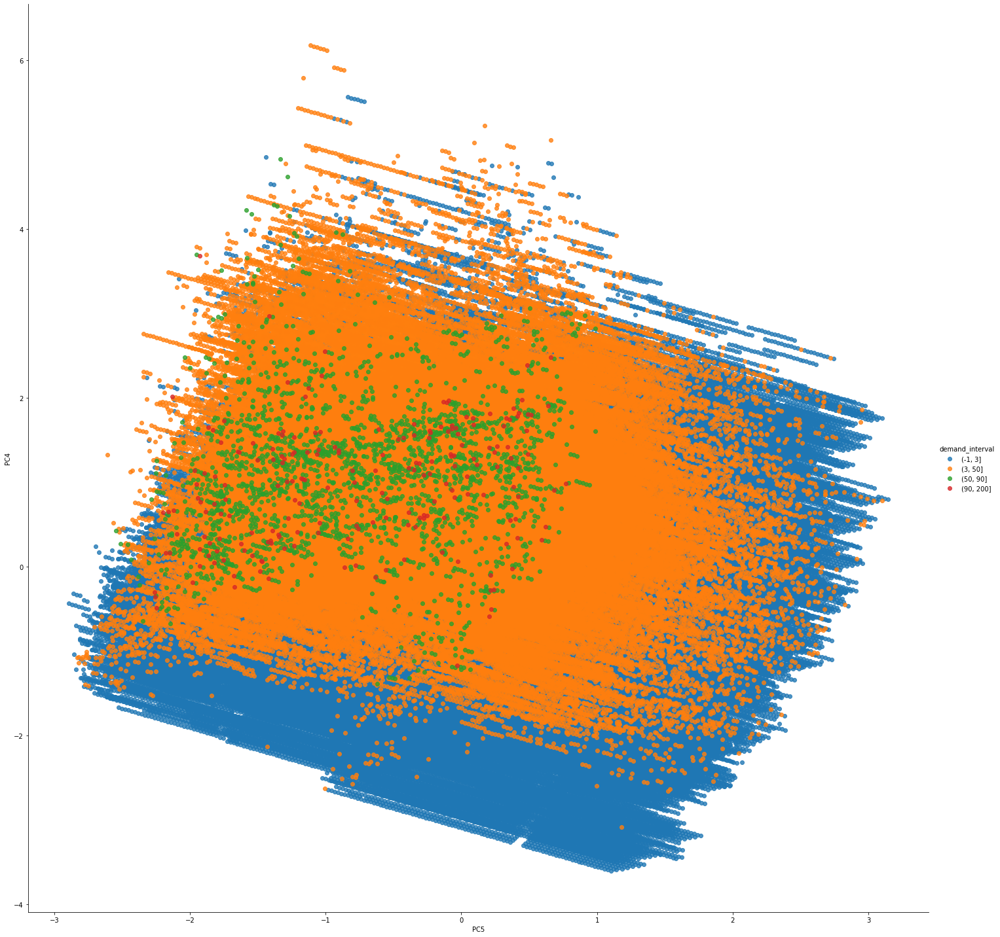

<Figure size 360x360 with 0 Axes>

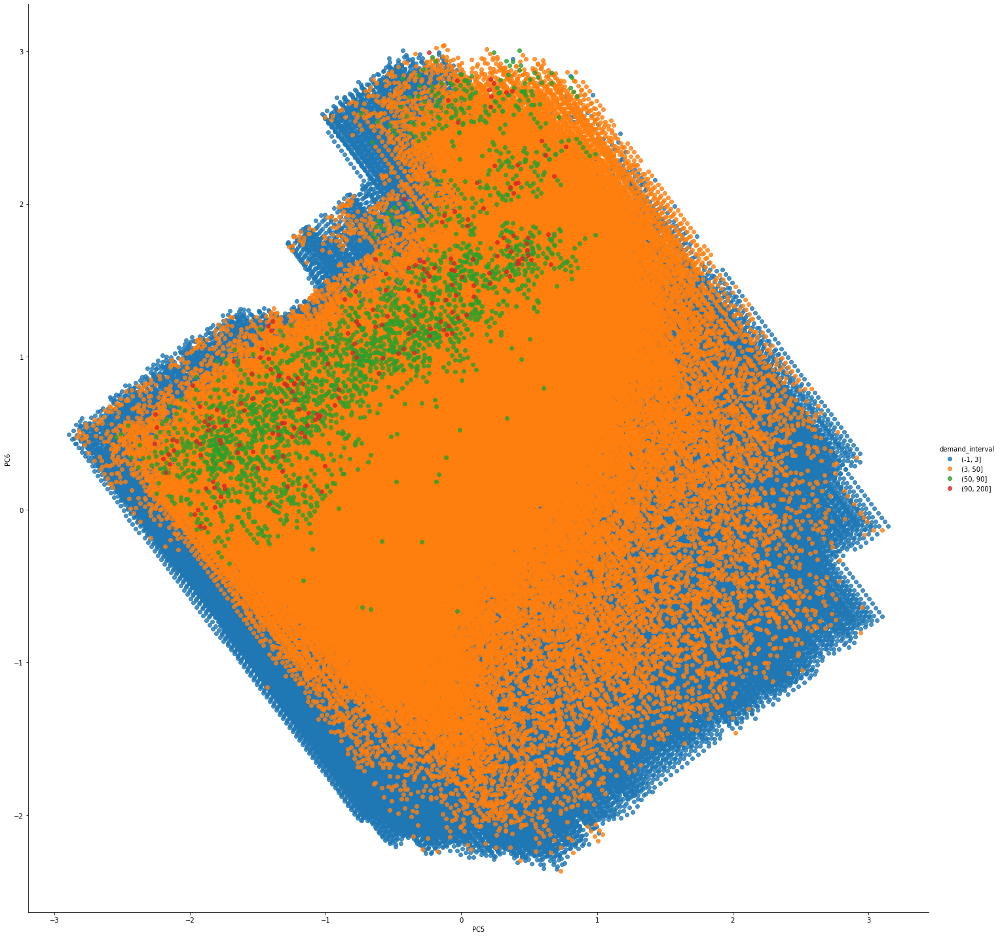

<Figure size 360x360 with 0 Axes>

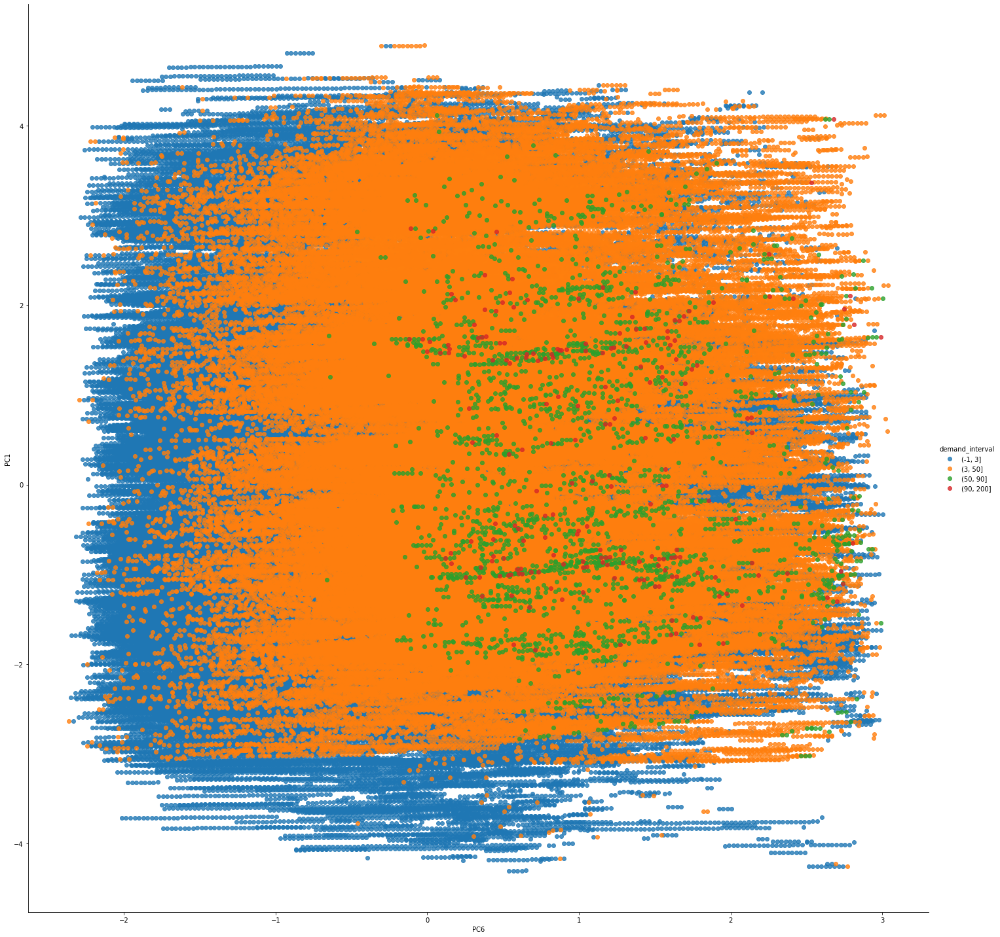

<Figure size 360x360 with 0 Axes>

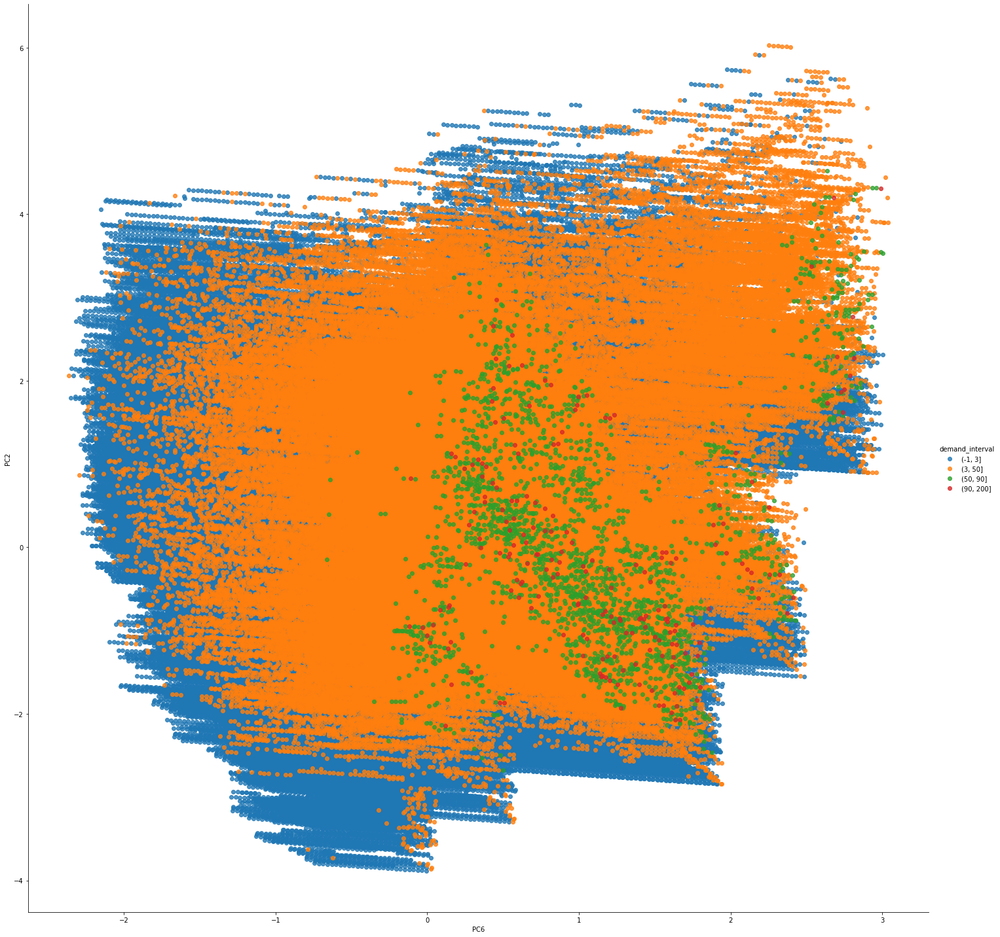

<Figure size 360x360 with 0 Axes>

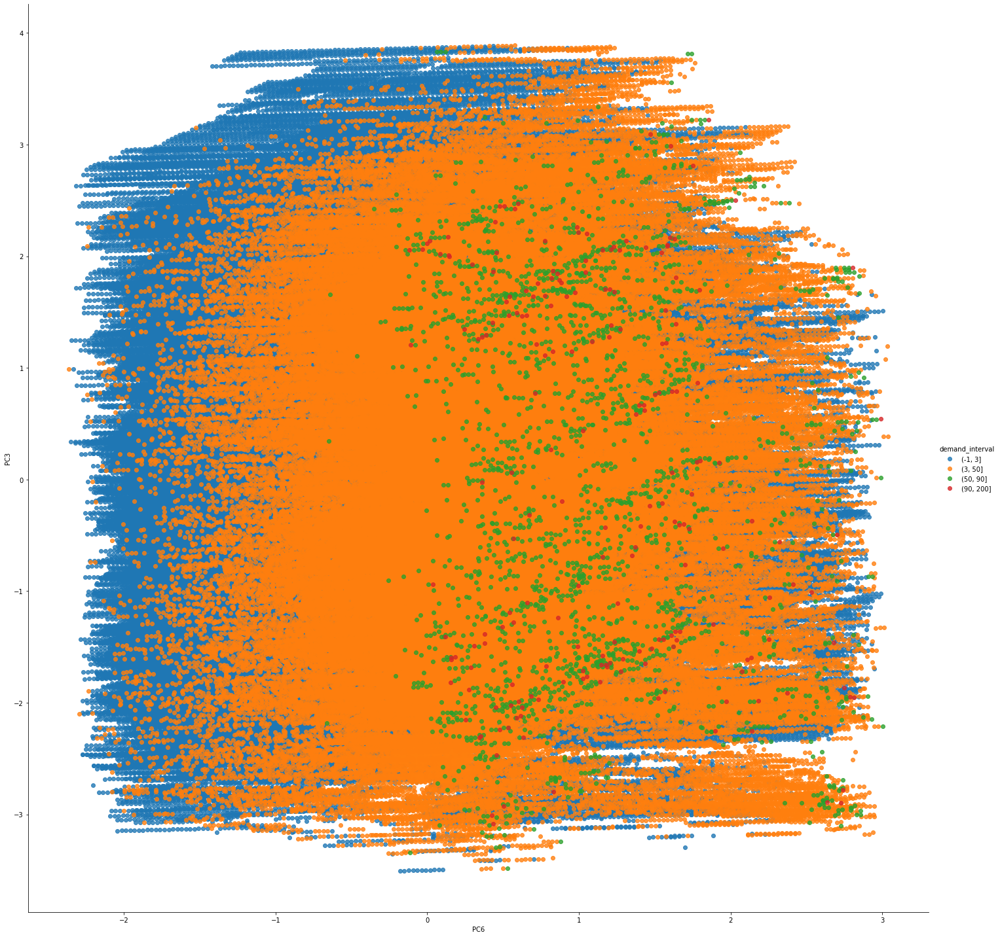

<Figure size 360x360 with 0 Axes>

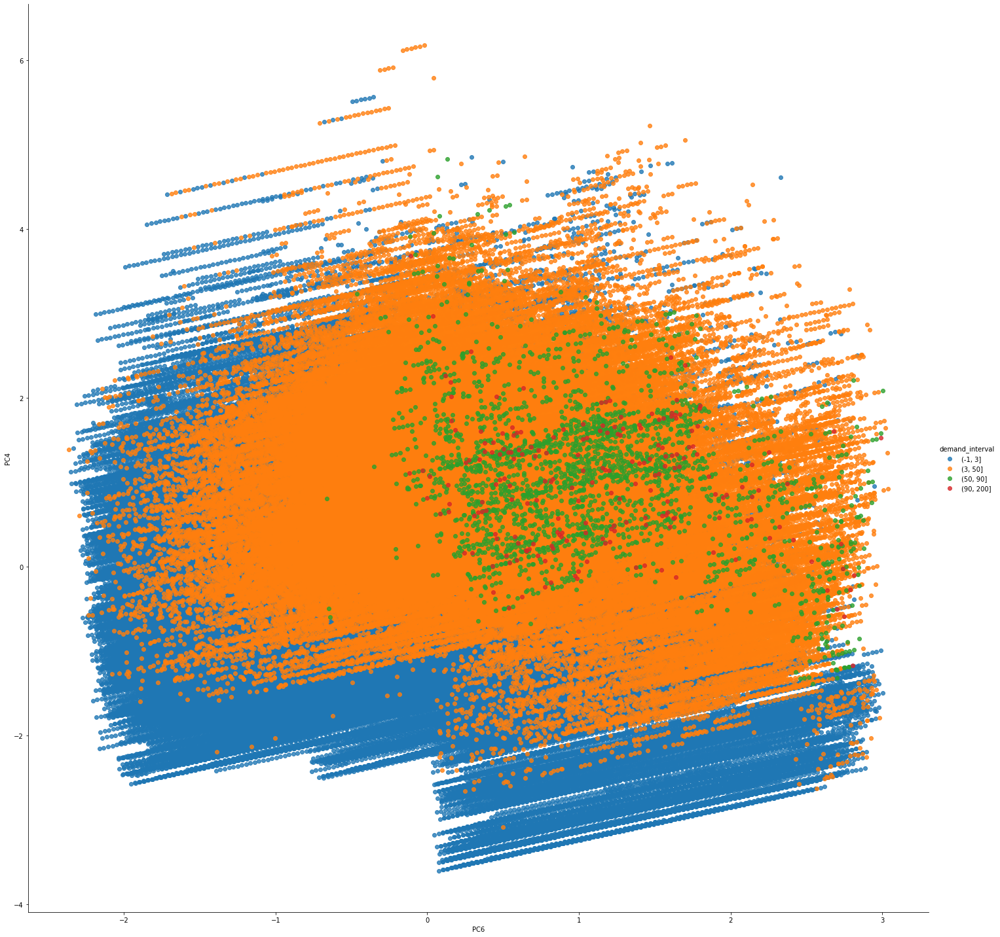

<Figure size 360x360 with 0 Axes>

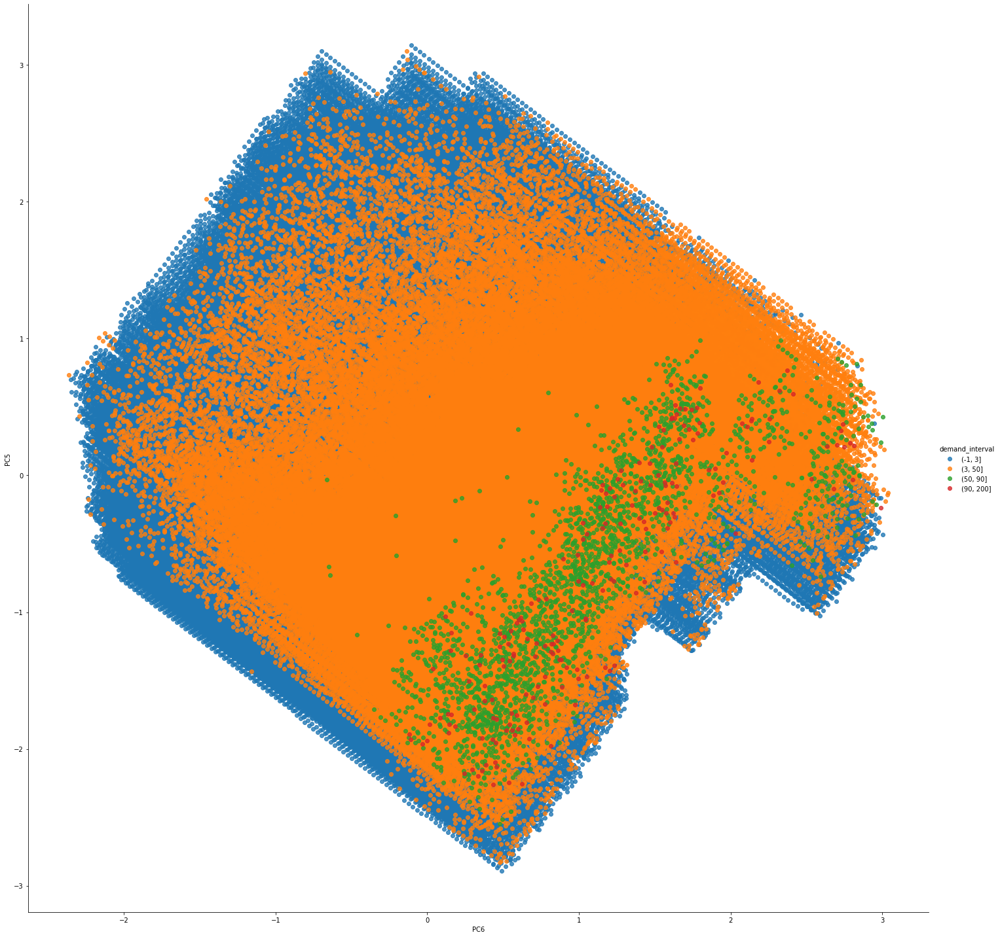

In [121]:

for pc1 in ["PC1", "PC2", "PC3", "PC4", "PC5", "PC6"]:
    for pc2 in ["PC1", "PC2", "PC3", "PC4", "PC5", "PC6"]:
        if pc1 == pc2:
            continue
        plt.figure(figsize=(5,5))
        sns.lmplot(pc1,
                   pc2,
                   hue='demand_interval',
                   data=pca_df,
                   fit_reg=False,
                   scatter=True,
                   size=20)

Text(0.5, 1.0, 'Variable factor map')

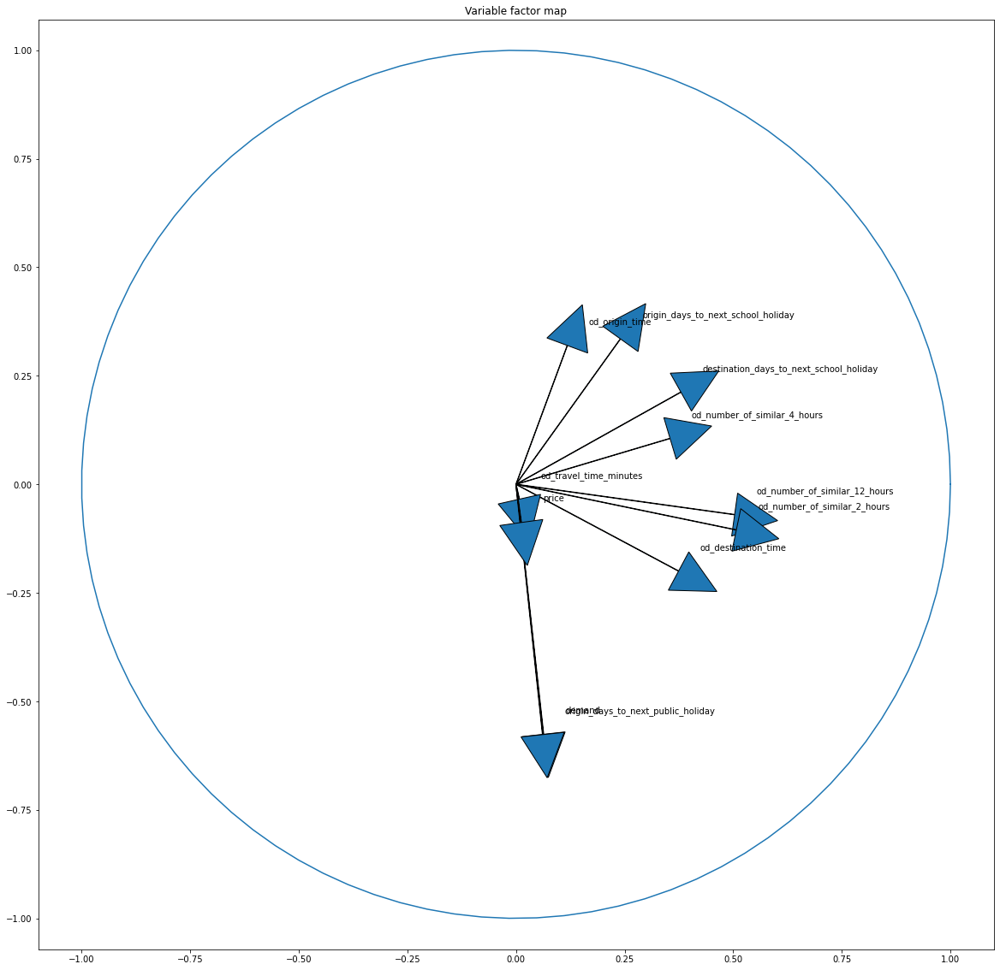

In [121]:
(fig, ax) = plt.subplots(figsize=(20, 20))
for i in range(0, pca.components_.shape[1]):
    ax.arrow(0,
             0,  
             pca.components_[0, i],  
             pca.components_[1, i],  
             head_width=0.1,
             head_length=0.1)

    plt.text(pca.components_[0, i] + 0.05,
             pca.components_[1, i] + 0.05,
             pca_df.columns.values[i])


an = np.linspace(0, 2 * np.pi, 100)
plt.plot(np.cos(an), np.sin(an))  
plt.axis('equal')
ax.set_title('Variable factor map')

## Machine learning

In [122]:
ml_cols = ['dataset_type', 'demand', 'destination_current_school_holiday',
       'od_number_of_similar_12_hours','od_number_of_similar_2_hours', 'od_number_of_similar_4_hours',
       'od_origin_week', 'od_travel_time_minutes',
       'origin_current_public_holiday', 
       'origin_days_to_next_public_holiday',
       'origin_days_to_next_school_holiday', 'price',
       'sale_day_x', 'sale_month', 'track_stations', 'night_origin',
       'night_destination', 'is_week_end', 'is_eom_track', 
         'sale_weekend']

In [156]:
df.columns

Index(['dataset_type', 'demand', 'destination_current_school_holiday',
       'destination_days_to_next_school_holiday', 'destination_station_name',
       'od_destination_time', 'od_number_of_similar_12_hours',
       'od_number_of_similar_2_hours', 'od_number_of_similar_4_hours',
       'od_origin_month', 'od_origin_time', 'od_origin_week',
       'od_origin_weekday', 'od_origin_year', 'od_travel_time_minutes',
       'origin_current_public_holiday', 'origin_current_school_holiday',
       'origin_days_to_next_public_holiday',
       'origin_days_to_next_school_holiday', 'origin_station_name', 'price',
       'sale_day', 'sale_day_x', 'sale_month', 'sale_weekday', 'sale_year',
       'departure_day_of_month', 'track_stations', 'night_origin',
       'night_destination', 'is_week_end', 'is_eom_track', 'sale_day_interval',
       'tarvel_time_interval', 'eom_sale', 'sale_weekend'],
      dtype='object')

In [157]:
ml_cols = [
 'dataset_type', 
 'demand', 
 'origin_current_public_holiday',
 'origin_current_school_holiday',
 'track_stations',
 'night_origin',
 'night_destination',
 'is_week_end',
 'is_eom_track',
 'sale_weekend', 
'destination_days_to_next_school_holiday',
    'od_number_of_similar_4_hours',
    'od_travel_time_minutes',
    'origin_days_to_next_public_holiday',
    'origin_days_to_next_school_holiday',
    'price',
    'sale_day_x'
]

In [159]:
mldf = df[ml_cols]
ml_cat_cols = [col for col in ml_cols if col in cat_columns]
for column in ml_cat_cols:
    dummy_df = pd.get_dummies(mldf[column])
    column_names = [column+f"{cname}" for cname in dummy_df.columns]
    mldf[column_names] = dummy_df

mldf = mldf.drop(ml_cat_cols, axis=1)
mldf

,dataset_type,demand,destination_days_to_next_school_holiday,od_number_of_similar_4_hours,od_travel_time_minutes,origin_days_to_next_public_holiday,origin_days_to_next_school_holiday,price,sale_day_x,origin_current_public_holiday0,...,night_originFalse,night_originTrue,night_destinationFalse,night_destinationTrue,is_week_endFalse,is_week_endTrue,is_eom_trackFalse,is_eom_trackTrue,sale_weekendFalse,sale_weekendTrue
0,training,1,-13,2,166,52,-6,26.65,-89,1,...,1,0,1,0,1,0,1,0,0,1
1,training,6,-13,2,166,52,-6,26.65,-88,1,...,1,0,1,0,1,0,1,0,1,0
2,training,5,-13,2,166,52,-6,26.65,-87,1,...,1,0,1,0,1,0,1,0,1,0
3,training,0,-13,2,166,52,-6,26.65,-86,1,...,1,0,1,0,1,0,1,0,1,0
4,training,0,-13,2,166,52,-6,26.65,-85,1,...,1,0,1,0,1,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
665401,testing,0,-14,2,34,1,-14,11.65,-5,0,...,0,1,0,1,0,1,0,1,1,0
665402,testing,0,-14,2,34,1,-14,11.65,-4,0,...,0,1,0,1,0,1,0,1,1,0
665403,testing,0,-14,2,34,1,-14,11.65,-3,0,...,0,1,0,1,0,1,0,1,1,0
665404,testing,0,-14,2,34,1,-14,11.65,-2,0,...,0,1,0,1,0,1,0,1,1,0


In [143]:
for i in range(0, n_components):
    mldf['PC' + str(i + 1)] = reduced[:, i]
mldf

,dataset_type,demand,origin_current_public_holiday0,origin_current_public_holiday1,origin_current_school_holiday0,origin_current_school_holiday1,sale_month1,sale_month2,sale_month3,sale_month4,...,is_eom_trackFalse,is_eom_trackTrue,sale_weekendFalse,sale_weekendTrue,PC1,PC2,PC3,PC4,PC5,PC6
0,training,1,1,0,0,1,0,0,0,0,...,1,0,0,1,-0.074284,1.330240,0.711930,-0.700121,1.730397,-0.578662
1,training,6,1,0,0,1,0,0,0,0,...,1,0,1,0,-0.073800,1.326761,0.712906,-0.689086,1.706424,-0.550360
2,training,5,1,0,0,1,0,0,0,0,...,1,0,1,0,-0.073317,1.323281,0.713883,-0.678051,1.682451,-0.522058
3,training,0,1,0,0,1,0,0,0,0,...,1,0,1,0,-0.072834,1.319801,0.714859,-0.667016,1.658478,-0.493755
4,training,0,1,0,0,1,0,0,0,0,...,1,0,1,0,-0.072350,1.316321,0.715835,-0.655981,1.634505,-0.465453
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
665401,testing,0,0,1,0,1,0,0,0,0,...,0,1,1,0,0.152482,0.679565,1.455209,-1.103934,-2.593594,0.235616
665402,testing,0,0,1,0,1,0,0,0,0,...,0,1,1,0,0.152966,0.676085,1.456185,-1.092899,-2.617567,0.263918
665403,testing,0,0,1,0,1,0,0,0,0,...,0,1,1,0,0.153449,0.672606,1.457162,-1.081864,-2.641541,0.292220
665404,testing,0,0,1,0,1,0,0,0,0,...,0,1,1,0,0.153932,0.669126,1.458138,-1.070829,-2.665514,0.320522


In [278]:
scaler = StandardScaler()

scaler.fit(mldf.drop(["dataset_type", "demand"], axis=1).values)
#for col in mldf.columns:
#    if col in ["dataset_type", "demand"]:
#        continue
#    mldf[col] = pd.DataFrame(scaler.transform(pd.DataFrame(mldf[col])),columns=[col]) #scaler.transform([mldf[col].values])[0]
X = mldf.copy()#StandardScaler().fit_transform(df_x_train.drop(["dataset_type", "demand"], axis=1).values)
y = mldf.demand
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)
X_train = X_train.drop(["dataset_type", "demand"], axis=1)
X_test = X_test.drop(["dataset_type", "demand"], axis=1)

In [ ]:

df_x_train = mldf[mldf.dataset_type == "training"]
oX_train = scaler.transform(df_x_train.drop(["dataset_type", "demand"], axis=1).values)#StandardScaler().fit_transform(df_x_train.drop(["dataset_type", "demand"], axis=1).values)
oy_train = df_x_train[df_x_train.dataset_type == "training"].demand.values;

df_x_test = mldf[mldf.dataset_type != "training"]
oX_test = scaler.transform(df_x_test.drop(["dataset_type", "demand"], axis=1).values)#StandardScaler().fit_transform(df_x_test.drop(["dataset_type", "demand"], axis=1).values)
oy_test = df_x_test[df_x_test.dataset_type != "training"].demand.values;

print(f"Training X : {oX_train.shape}")
print(f"Training y : {oy_train.shape}")
print(f"Testing X : {oX_test.shape}")
print(f"Testing y : {oy_test.shape}")

In [279]:
xgb_model = xgb.XGBRegressor(objective ='reg:squarederror')
xgb_model.fit(X_train, y_train)

XGBRegressor(objective='reg:squarederror')

In [280]:
y_pred = xgb_model.predict(X_train)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_train, predictions)
print("Train Accuracy: %.2f%%" % (accuracy * 100.0))

y_pred = xgb_model.predict(X_test)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_test, predictions)
print("Test Accuracy: %.2f%%" % (accuracy * 100.0))

Train Accuracy: 47.73%
Test Accuracy: 47.98%


In [281]:

y_pred = xgb_model.predict(X_train)
predictions = [round(value) for value in y_pred]
loss = mean_squared_error(y_train, predictions)
print("Train loss: %.2f" % (loss))

y_pred = xgb_model.predict(X_test)
predictions = [round(value) for value in y_pred]
loss = mean_squared_error(y_test, predictions)
print("Test loss: %.2f" % (loss))

Train loss: 15.24
Test loss: 15.55


Text(0.5, 1.0, 'Importance')

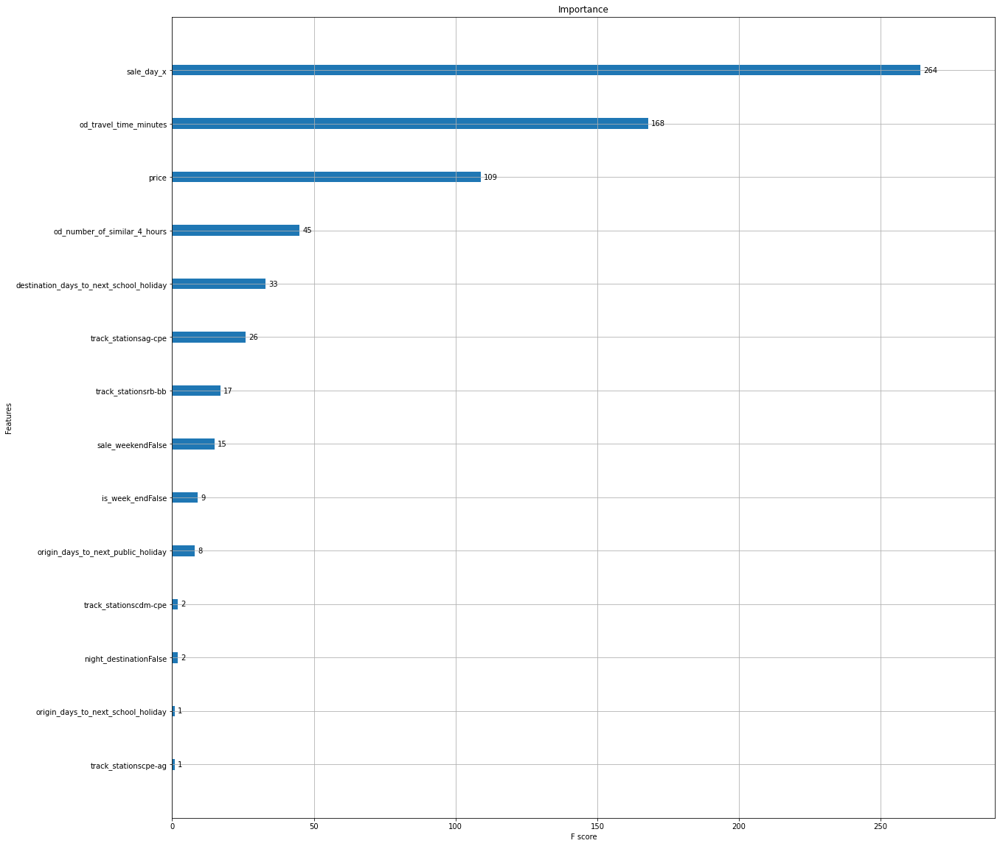

In [282]:
fig, ax = plt.subplots(1,1,figsize=(20,20))
xgb.plot_importance(xgb_model, ax=ax)
plt.title("Importance")

Text(0.5, 1.0, 'Cover')

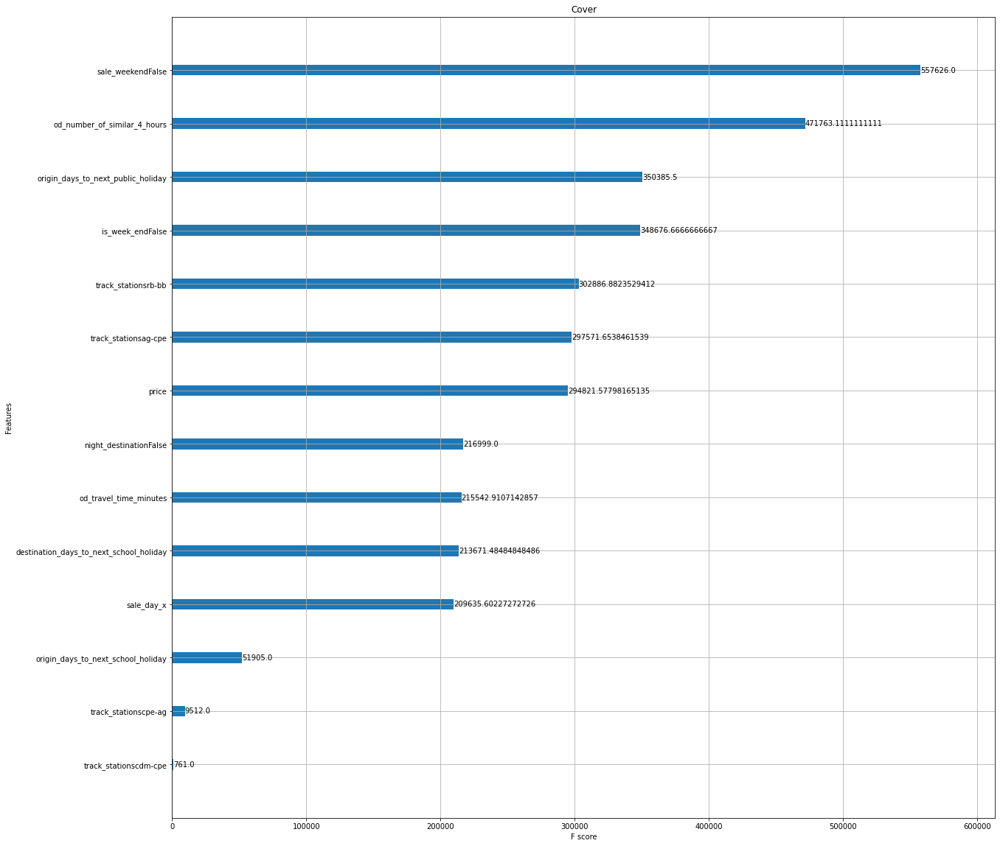

In [283]:
fig, ax = plt.subplots(1,1,figsize=(20,20))
xgb.plot_importance(xgb_model, importance_type="cover", ax=ax)
plt.title("Cover")

Text(0.5, 1.0, 'Gain')

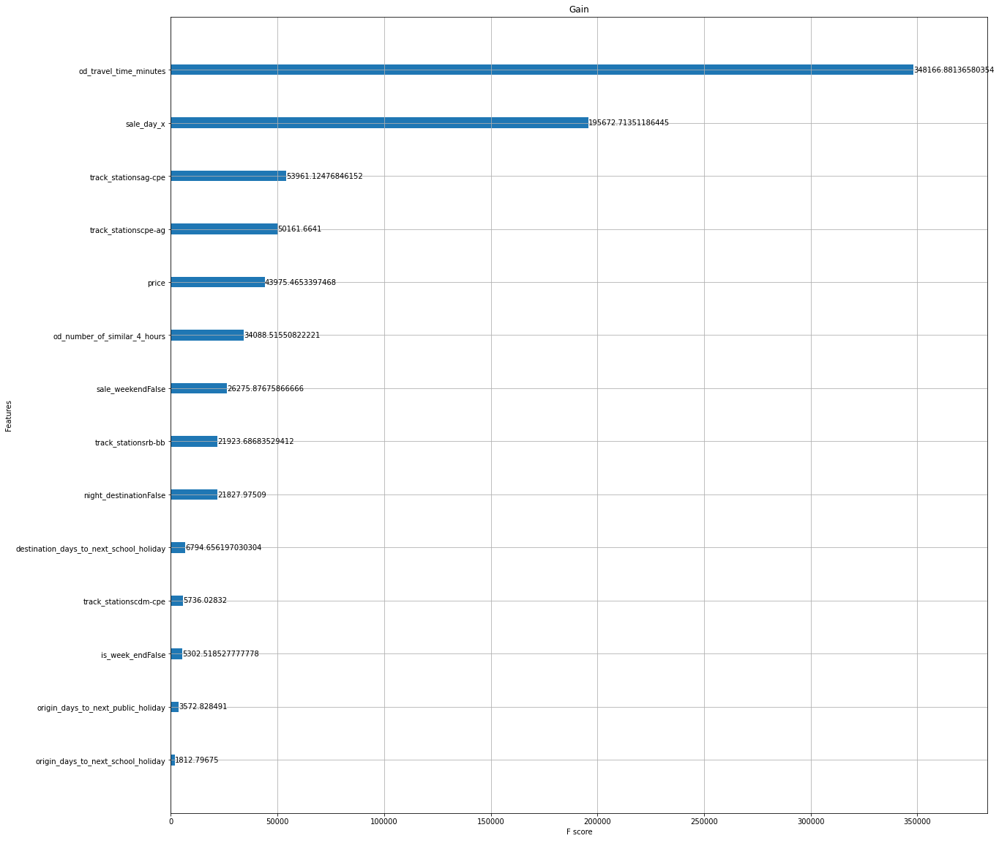

In [284]:
fig, ax = plt.subplots(1,1,figsize=(20,20))
xgb.plot_importance(xgb_model, importance_type="gain", ax=ax)
plt.title("Gain")


In [285]:
shap.initjs()
explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer.shap_values(X.drop(["demand", "dataset_type"], axis=1))
shap.force_plot(explainer.expected_value, shap_values[0,:], X.drop(["demand", "dataset_type"], axis=1).sample(1000).iloc[0,:])


In [286]:
shap.force_plot(explainer.expected_value, shap_values[:1000,:], X.drop(["demand", "dataset_type"], axis=1).sample(1000).iloc[:1000,:])


In [287]:
preprocessed_df = df.copy()
ml_cat_cols = [col for col in ml_cols if col in cat_columns]
for column in ml_cat_cols:
    dummy_df = pd.get_dummies(preprocessed_df[column])
    column_names = [column+f"{cname}" for cname in dummy_df.columns]
    preprocessed_df[column_names] = dummy_df
preprocessed_df = preprocessed_df.drop(ml_cat_cols, axis=1)

preprocessed_df = preprocessed_df[preprocessed_df.dataset_type != "training"][X.columns]
preprocessed_df


,dataset_type,demand,destination_days_to_next_school_holiday,od_number_of_similar_4_hours,od_travel_time_minutes,origin_days_to_next_public_holiday,origin_days_to_next_school_holiday,price,sale_day_x,origin_current_public_holiday0,...,night_originFalse,night_originTrue,night_destinationFalse,night_destinationTrue,is_week_endFalse,is_week_endTrue,is_eom_trackFalse,is_eom_trackTrue,sale_weekendFalse,sale_weekendTrue
632841,testing,0,1,1,170,16,1,20.65,-89,1,...,1,0,1,0,1,0,1,0,0,1
632842,testing,0,1,1,170,16,1,20.65,-88,1,...,1,0,1,0,1,0,1,0,1,0
632843,testing,0,1,1,170,16,1,20.65,-87,1,...,1,0,1,0,1,0,1,0,1,0
632844,testing,0,1,1,170,16,1,20.65,-86,1,...,1,0,1,0,1,0,1,0,1,0
632845,testing,0,1,1,170,16,1,20.65,-85,1,...,1,0,1,0,1,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
665401,testing,0,-14,2,34,1,-14,11.65,-5,0,...,0,1,0,1,0,1,0,1,1,0
665402,testing,0,-14,2,34,1,-14,11.65,-4,0,...,0,1,0,1,0,1,0,1,1,0
665403,testing,0,-14,2,34,1,-14,11.65,-3,0,...,0,1,0,1,0,1,0,1,1,0
665404,testing,0,-14,2,34,1,-14,11.65,-2,0,...,0,1,0,1,0,1,0,1,1,0


loss for interval [-90, -60[ = 2.423144306131858
loss for interval [-60, -30[ = 15.459212061383829
loss for interval [-30, -20[ = 45.62875197472354
loss for interval [-20, -15[ = 88.19569892473119
loss for interval [-15, -10[ = 133.77471636952998
loss for interval [-10, -7[ = 223.6011396011396
loss for interval [-7, -6[ = 380.55737704918033
loss for interval [-6, -5[ = 406.0498442367601
loss for interval [-5, -3[ = 469.26166666666666
loss for interval [-3, -2[ = 580.6533333333333
loss for interval [-2, -1[ = 781.0183823529412
loss for interval [-1, 0[ = 762.2764976958525


Text(0.5, 1.0, 'Data size')

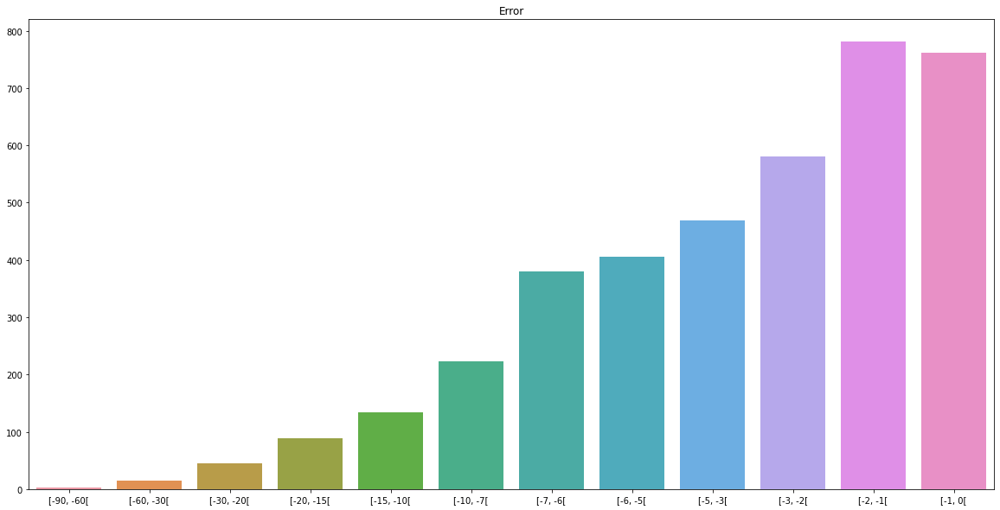

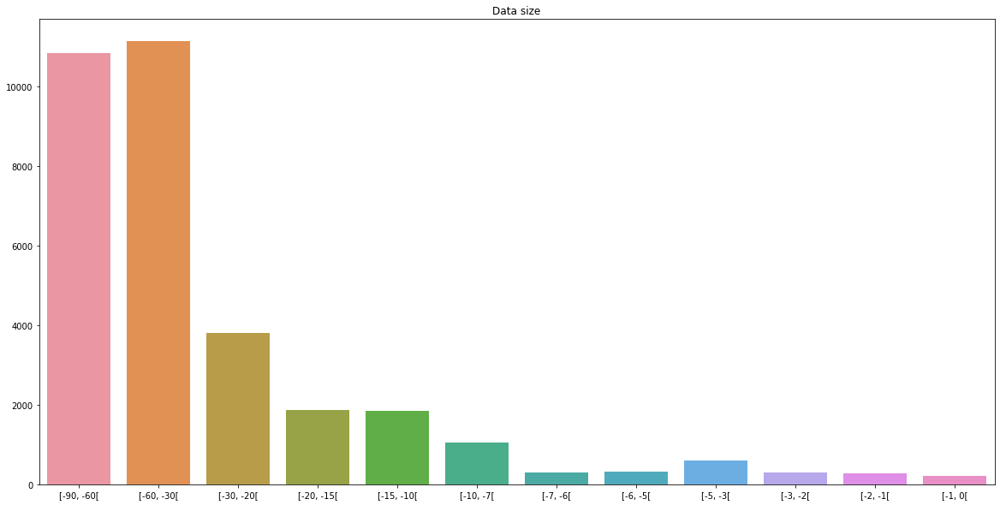

In [289]:
intervals = [-60, -30, -20, -15, -10, -7, -6, -5, -3, -2, -1, 0]
intervals_loss = []
str_intervals = []
subdf_sizes = []

lower_val = -90
for interval in intervals:
    subdf = preprocessed_df[preprocessed_df.apply(lambda x: x.sale_day_x>=lower_val and x.sale_day_x<interval, axis=1)]
    if subdf.shape[0] == 0:
        print(f"interval [{lower_val}-{interval}[ is empty")
        lower_val=interval
        continue
    
    interval_X = subdf.copy()
    """
    for col in interval_X.columns:
        if col in ["dataset_type", "demand"]:
            continue
        interval_X[col] = pd.DataFrame(scaler.transform(pd.DataFrame(interval_X[col])),columns=[col])
    """
    if interval_X.shape[0] == 0:
        print(f"interval [{lower_val}-{interval}[ is empty")
        lower_val=interval
        continue
        
    y_pred = xgb_model.predict(interval_X.drop(["dataset_type", "demand"], axis=1))
    predictions = [round(value) for value in y_pred]
    
    loss = mean_squared_error(subdf.demand.values, predictions)
    intervals_loss.append(loss)
    str_intervals.append(f"[{lower_val}, {interval}[")
    subdf_sizes.append(subdf.shape[0])
    print(f"loss for interval [{lower_val}, {interval}[ = {loss}")
    lower_val = interval

plt.figure(figsize=(20,10))
sns.barplot(x=str_intervals, y=intervals_loss).set_title("Error")
plt.figure(figsize=(20,10))
sns.barplot(x=str_intervals, y=subdf_sizes).set_title("Data size")

In [305]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras.optimizers import SGD, Adam


model = Sequential()
model.add(BatchNormalization())
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.2))

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.2))

model.add(Dense(32, activation='relu'))
model.add(Dropout(0.1))
model.add(Dense(1, activation='relu'))

sgd = SGD(lr=0.01, decay=1e-6, momentum=0.9, nesterov=True)
adam = Adam(lr = 0.0001, decay=1e-6)
model.compile(loss='mean_squared_error', optimizer=adam)
hist = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=40, batch_size=16, verbose=1)


Epoch 1/40
37430/37430 [==============================] - 120s 3ms/step - loss: 30.2387 - val_loss: 23.5725
Epoch 2/40
37430/37430 [==============================] - 118s 3ms/step - loss: 25.2263 - val_loss: 19.5274
Epoch 3/40
33008/37430 [=========================>....] - ETA: 13s - loss: 24.3898

KeyboardInterrupt: 

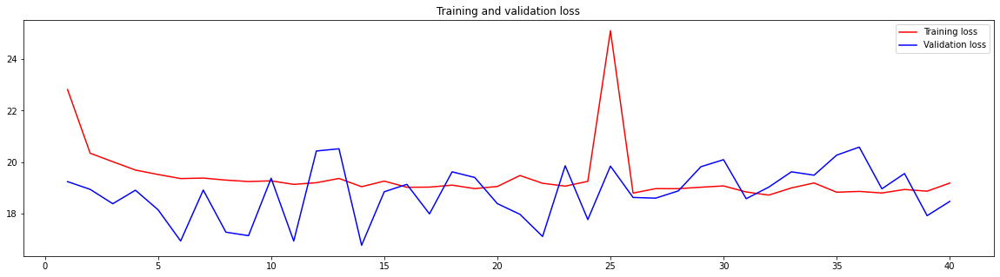

In [304]:
loss = hist.history['loss']
val_loss = hist.history['val_loss']
import matplotlib.pyplot as plt

epochs = range(1, len(loss) + 1)

plt.figure(figsize=(20,5))

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()



loss for interval [-90, -60[ = 0.63144306131858
loss for interval [-60, -30[ = 18.990666786323253
loss for interval [-30, -20[ = 56.19773565034229
loss for interval [-20, -15[ = 104.05537634408603
loss for interval [-15, -10[ = 153.71558344623128
loss for interval [-10, -7[ = 249.66257251887993
loss for interval [-7, -6[ = 416.5579724533025
loss for interval [-6, -5[ = 444.7914892898619
loss for interval [-5, -3[ = 508.7481276375995
loss for interval [-3, -2[ = 621.0132742192412
loss for interval [-2, -1[ = 824.4227438969908
loss for interval [-1, 0[ = 802.4746158370249


Text(0.5, 1.0, 'Data size')

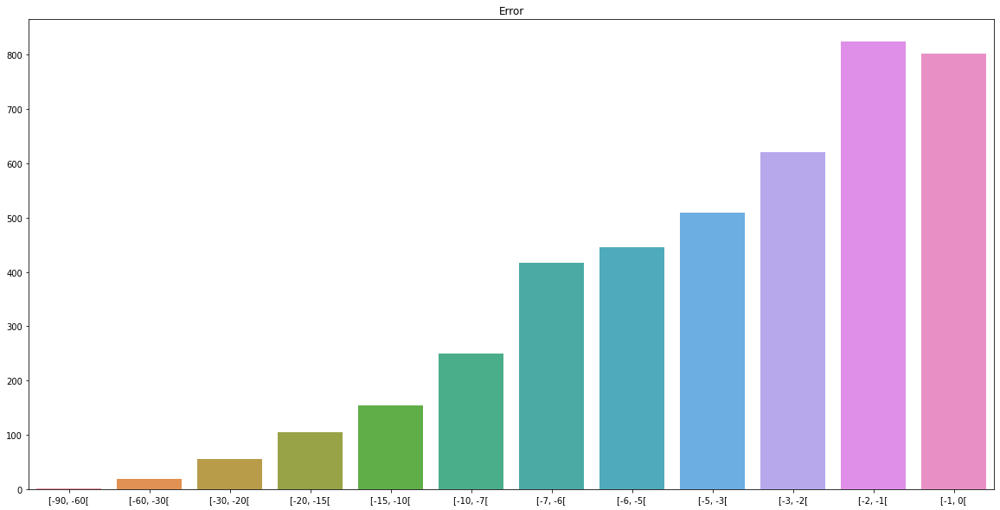

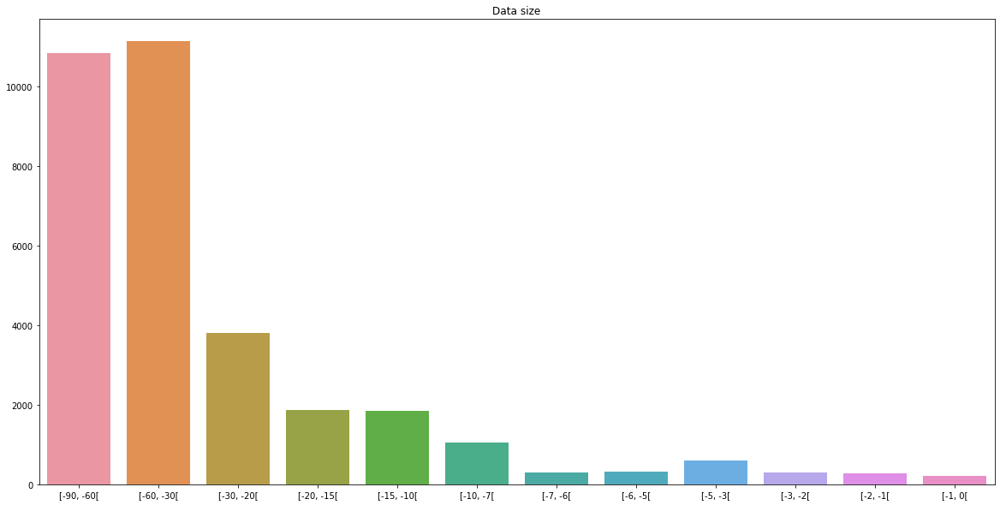

In [300]:
intervals = [-60, -30, -20, -15, -10, -7, -6, -5, -3, -2, -1, 0]
intervals_loss = []
str_intervals = []
subdf_sizes = []

lower_val = -90
for interval in intervals:
    subdf = preprocessed_df[preprocessed_df.apply(lambda x: x.sale_day_x>=lower_val and x.sale_day_x<interval, axis=1)]
    if subdf.shape[0] == 0:
        print(f"interval [{lower_val}-{interval}[ is empty")
        lower_val=interval
        continue
    
    interval_X = subdf.copy()
    
    if interval_X.shape[0] == 0:
        print(f"interval [{lower_val}-{interval}[ is empty")
        lower_val=interval
        continue
    y_pred = model.predict(interval_X.drop(["dataset_type", "demand"], axis=1))
    y_pred = y_pred.reshape((y_pred.shape[0],))
    predictions = [np.round(y_pred) for value in y_pred]
    
    loss = np.square(np.subtract(subdf.demand.values,y_pred)).mean()
    
    intervals_loss.append(loss)
    str_intervals.append(f"[{lower_val}, {interval}[")
    subdf_sizes.append(subdf.shape[0])
    print(f"loss for interval [{lower_val}, {interval}[ = {loss}")
    lower_val = interval

plt.figure(figsize=(20,10))
sns.barplot(x=str_intervals, y=intervals_loss).set_title("Error")
plt.figure(figsize=(20,10))
sns.barplot(x=str_intervals, y=subdf_sizes).set_title("Data size")